# Test 4: regional gravity field

import packages

In [1]:
from __future__ import annotations

%load_ext autoreload
%autoreload 2

import copy
import logging
import os
import pathlib
import pickle
import string

import numpy as np
import scipy as sp
import verde as vd
import xarray as xr
from polartoolkit import maps, profiles
from polartoolkit import utils as polar_utils

from synthetic_bathymetry_inversion import synthetic
import synthetic_bathymetry_inversion.plotting as synth_plotting


os.environ["POLARTOOLKIT_HEMISPHERE"] = "south"

logging.getLogger().setLevel(logging.INFO)

from invert4geom import inversion, optimization, plotting, regional, uncertainty, utils

/home/mattd/miniforge3/envs/synthetic_bathymetry_inversion/lib/python3.12/site-packages/esmpy/interface/loadESMF.py:94: VersionWarning:

ESMF installation version 8.8.0, ESMPy version 8.8.0b0



In [2]:
fpath = "../results/Ross_Sea/Ross_Sea_04"

# Get synthetic model data

INFO:polartoolkit:converting to be reference to the WGS84 ellipsoid
INFO:polartoolkit:spacing larger than original, filtering and resampling
grdsample [WARNING]: Output sampling interval in x exceeds input interval and may lead to aliasing.
grdsample [WARNING]: Output sampling interval in y exceeds input interval and may lead to aliasing.


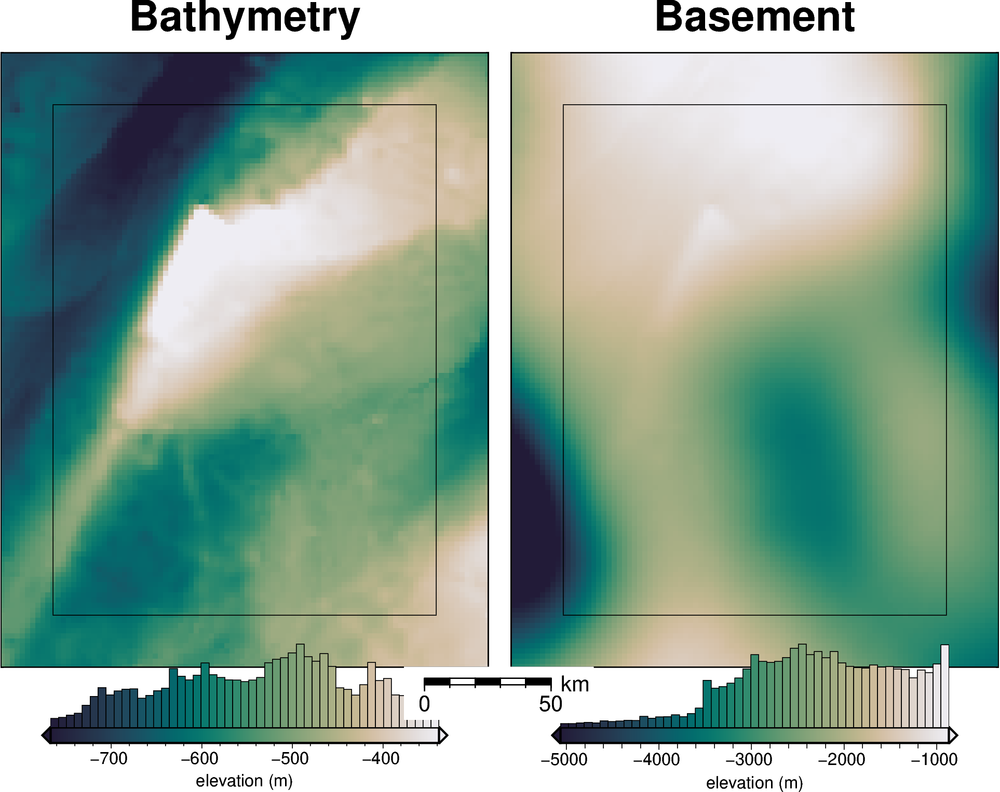

  0%|          | 0/7676 [00:00<?, ?it/s]

  0%|          | 0/7676 [00:00<?, ?it/s]

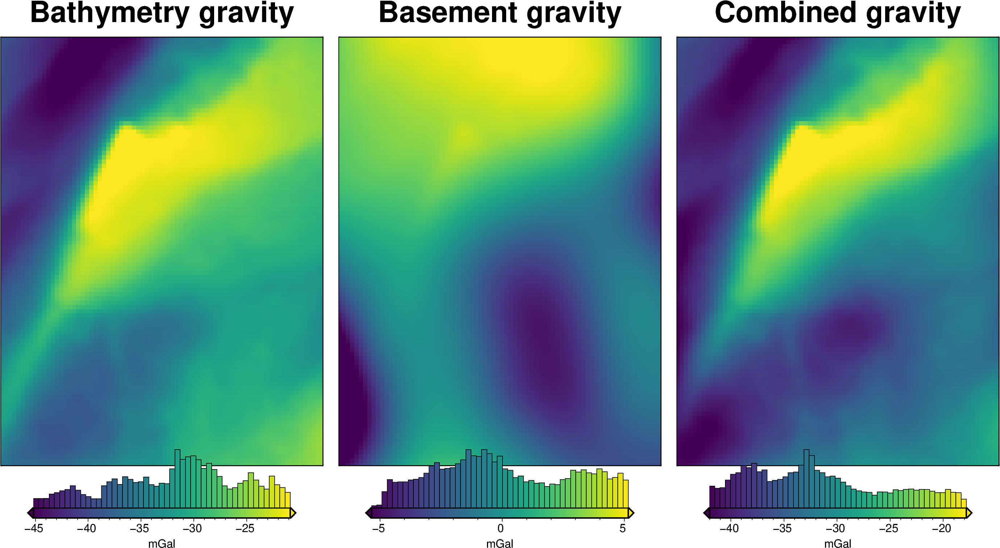

In [3]:
# set grid parameters
spacing = 2e3
inversion_region = (-40e3, 110e3, -1600e3, -1400e3)

true_density_contrast = 1476

bathymetry, basement, grav_df = synthetic.load_synthetic_model(
    spacing=spacing,
    inversion_region=inversion_region,
    buffer=spacing * 10,
    basement=True,
    zref=0,
    bathymetry_density_contrast=true_density_contrast,
)
buffer_region = polar_utils.get_grid_info(bathymetry)[1]

In [4]:
# normalize regional gravity between -1 and 1
grav_df["basement_grav_normalized"] = (
    vd.grid_to_table(
        utils.normalize_xarray(
            grav_df.set_index(["northing", "easting"]).to_xarray().basement_grav,
            low=-1,
            high=1,
        )
    )
    .reset_index()
    .basement_grav
)
grav_df = grav_df.drop(columns=["basement_grav", "disturbance", "gravity_anomaly"])

In [5]:
# re-scale the regional gravity
regional_grav = utils.normalize_xarray(
    grav_df.set_index(["northing", "easting"]).to_xarray().basement_grav_normalized,
    low=0,
    high=90,
).rename("basement_grav")
regional_grav -= regional_grav.mean()

# add to dataframe
grav_df["basement_grav"] = vd.grid_to_table(regional_grav).reset_index().basement_grav

# add basement and bathymetry forward gravities together to make observed gravity
grav_df["gravity_anomaly"] = grav_df.bathymetry_grav + grav_df.basement_grav

new_reg = grav_df.set_index(["northing", "easting"]).to_xarray().basement_grav
new_reg -= new_reg.mean()
print(utils.rmse(new_reg))

18.410935114689675


In [6]:
grav_df.basement_grav.std()

18.412134485077235

In [7]:
grav_df.bathymetry_grav.std()

6.45813760697804

In [8]:
grav_df.gravity_anomaly.std()

18.716723557434452

In [9]:
grav_df.gravity_anomaly.std() / grav_df.basement_grav.std()

1.0165428442098379

In [10]:
grav_df

,northing,easting,upward,bathymetry_grav,basement_grav_normalized,basement_grav,gravity_anomaly
0,-1600000.0,-40000.0,1000.0,-35.551041,-0.576200,-36.298936,-71.849978
1,-1600000.0,-38000.0,1000.0,-36.054652,-0.523887,-33.944812,-69.999465
2,-1600000.0,-36000.0,1000.0,-36.473148,-0.467097,-31.389260,-67.862409
3,-1600000.0,-34000.0,1000.0,-36.755612,-0.406792,-28.675560,-65.431172
4,-1600000.0,-32000.0,1000.0,-36.951032,-0.343951,-25.847705,-62.798738
...,...,...,...,...,...,...,...
7671,-1400000.0,102000.0,1000.0,-25.760380,0.399106,7.589836,-18.170543
7672,-1400000.0,104000.0,1000.0,-25.911731,0.334770,4.694748,-21.216982
7673,-1400000.0,106000.0,1000.0,-26.033127,0.268772,1.724824,-24.308303
7674,-1400000.0,108000.0,1000.0,-26.122232,0.201841,-1.287092,-27.409324


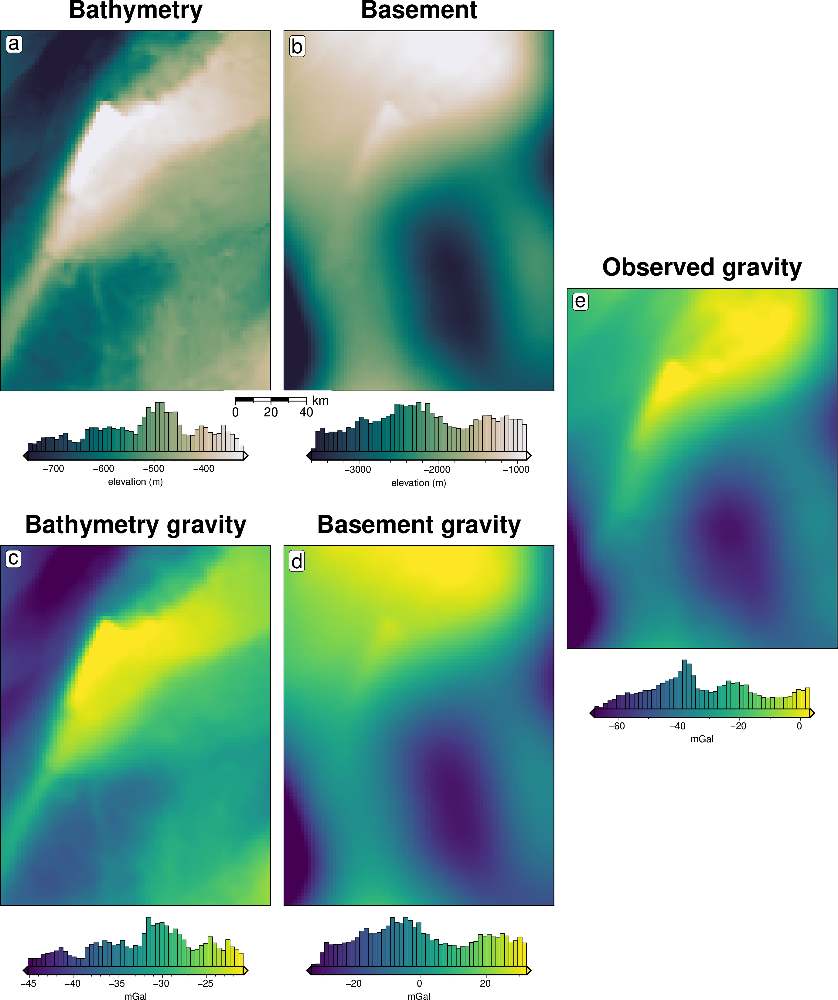

In [11]:
grav_grid = grav_df.set_index(["northing", "easting"]).to_xarray()

fig = maps.plot_grd(
    bathymetry,
    region=inversion_region,
    fig_height=10,
    title="Bathymetry",
    hist=True,
    cmap="rain",
    reverse_cpt=True,
    cbar_label="elevation (m)",
    robust=True,
)
fig.text(
    position="TL",
    text="a",
    fill="white",
    pen=True,
    font="16p,Helvetica,black",
    offset="j.2/.2",
    clearance="+tO",
    no_clip=True,
)

fig = maps.plot_grd(
    basement,
    region=inversion_region,
    fig_height=10,
    title="Basement",
    hist=True,
    cmap="rain",
    reverse_cpt=True,
    cbar_label="elevation (m)",
    fig=fig,
    origin_shift="xshift",
    robust=True,
    # frame=["nSEw", "xaf10000", "yaf10000"],
    scalebar=True,
    scale_position="n-.05/-.03",
)
fig.text(
    position="TL",
    text="b",
    fill="white",
    pen=True,
    font="16p,Helvetica,black",
    offset="j.2/.2",
    clearance="+tO",
    no_clip=True,
)

# shift down and 3 to the left
fig = maps.plot_grd(
    grav_grid.bathymetry_grav,
    region=inversion_region,
    fig_height=10,
    title="Bathymetry gravity",
    hist=True,
    cbar_label="mGal",
    fig=fig,
    origin_shift="both",
    xshift_amount=-1,
    yshift_amount=-1,
    robust=True,
)
fig.text(
    position="TL",
    text="c",
    fill="white",
    pen=True,
    font="16p,Helvetica,black",
    offset="j.2/.2",
    clearance="+tO",
    no_clip=True,
)
fig = maps.plot_grd(
    grav_grid.basement_grav,
    region=inversion_region,
    fig_height=10,
    title="Basement gravity",
    hist=True,
    cbar_label="mGal",
    fig=fig,
    origin_shift="xshift",
    robust=True,
)
fig.text(
    position="TL",
    text="d",
    fill="white",
    pen=True,
    font="16p,Helvetica,black",
    offset="j.2/.2",
    clearance="+tO",
    no_clip=True,
)
fig = maps.plot_grd(
    grav_grid.gravity_anomaly,
    region=inversion_region,
    fig_height=10,
    title="Observed gravity",
    hist=True,
    cbar_label="mGal",
    fig=fig,
    origin_shift="both",
    yshift_amount=0.5,
    robust=True,
)
fig.text(
    position="TL",
    text="e",
    fill="white",
    pen=True,
    font="16p,Helvetica,black",
    offset="j.2/.2",
    clearance="+tO",
    no_clip=True,
)

fig.show()

# Make starting bathymetry model

In [12]:
# semi-regularly spaced
constraint_points = synthetic.constraint_layout_number(
    # shape=(4, 5),
    shape=(6, 7),
    region=inversion_region,
    padding=-spacing,
    shapefile="../results/Ross_Sea_outline.shp",
    add_outside_points=True,
    grid_spacing=spacing,
)

# sample true topography at these points
constraint_points = utils.sample_grids(
    constraint_points,
    bathymetry,
    "true_upward",
    coord_names=("easting", "northing"),
)
constraint_points["upward"] = constraint_points.true_upward
constraint_points.head()

,northing,easting,inside,true_upward,upward
0,-1600000.0,-40000.0,False,-601.093811,-601.093811
1,-1600000.0,-38000.0,False,-609.216797,-609.216797
2,-1600000.0,-36000.0,False,-616.356018,-616.356018
3,-1600000.0,-34000.0,False,-621.262207,-621.262207
4,-1600000.0,-32000.0,False,-625.510864,-625.510864


In [13]:
# grid the sampled values using verde
starting_topography_kwargs = dict(
    method="splines",
    region=buffer_region,
    spacing=spacing,
    constraints_df=constraint_points,
    dampings=None,
)

starting_bathymetry = utils.create_topography(**starting_topography_kwargs)

starting_bathymetry

<xarray.DataArray 'scalars' (northing: 121, easting: 96)> Size: 93kB
array([[-541.24376755, -544.57145531, -547.9225961 , ..., -360.00002858,
        -357.06763298, -354.19952961],
       [-543.34365605, -546.81640128, -550.35222195, ..., -362.90249581,
        -359.9686979 , -357.11426815],
       [-545.05496589, -548.66001144, -552.37483947, ..., -365.66133988,
        -362.73264883, -359.9004747 ],
       ...,
       [-591.95330237, -595.51878249, -599.06866787, ..., -440.89364102,
        -440.6949685 , -440.40606698],
       [-590.53129824, -594.09072644, -597.6407624 , ..., -440.69206448,
        -440.42575788, -440.07250027],
       [-589.16627633, -592.73500682, -596.30206449, ..., -440.51808973,
        -440.17189745, -439.74486709]])
Coordinates:
  * easting   (easting) float64 768B -6e+04 -5.8e+04 ... 1.28e+05 1.3e+05
  * northing  (northing) float64 968B -1.62e+06 -1.618e+06 ... -1.38e+06
Attributes:
    metadata:  Generated by SplineCV(cv=KFold(n_splits=5, random_state=0, shu...
    damping:   None

In [14]:
# sample the inverted topography at the constraint points
constraint_points = utils.sample_grids(
    constraint_points,
    starting_bathymetry,
    "starting_bathymetry",
    coord_names=("easting", "northing"),
)

constraint_points["dif"] = (
    constraint_points.true_upward - constraint_points.starting_bathymetry
)
rmse = utils.rmse(constraint_points.dif)
print(f"RMSE: {rmse:.2f} m")
constraint_points

RMSE: 0.03 m


,northing,easting,inside,true_upward,upward,starting_bathymetry,dif
0,-1.600000e+06,-4.000000e+04,False,-601.093811,-601.093811,-601.093811,0.000000
1,-1.600000e+06,-3.800000e+04,False,-609.216797,-609.216797,-609.216797,0.000000
2,-1.600000e+06,-3.600000e+04,False,-616.356018,-616.356018,-616.356018,0.000000
3,-1.600000e+06,-3.400000e+04,False,-621.262207,-621.262207,-621.262207,0.000000
4,-1.600000e+06,-3.200000e+04,False,-625.510864,-625.510864,-625.510864,0.000000
...,...,...,...,...,...,...,...
881,-1.418571e+06,-3.637979e-12,True,-747.305404,-747.305404,-747.288886,-0.016518
882,-1.418571e+06,2.333333e+04,True,-619.672029,-619.672029,-619.459731,-0.212298
883,-1.418571e+06,4.666667e+04,True,-505.761627,-505.761627,-505.739907,-0.021720
884,-1.418571e+06,7.000000e+04,True,-447.753376,-447.753376,-447.783133,0.029757


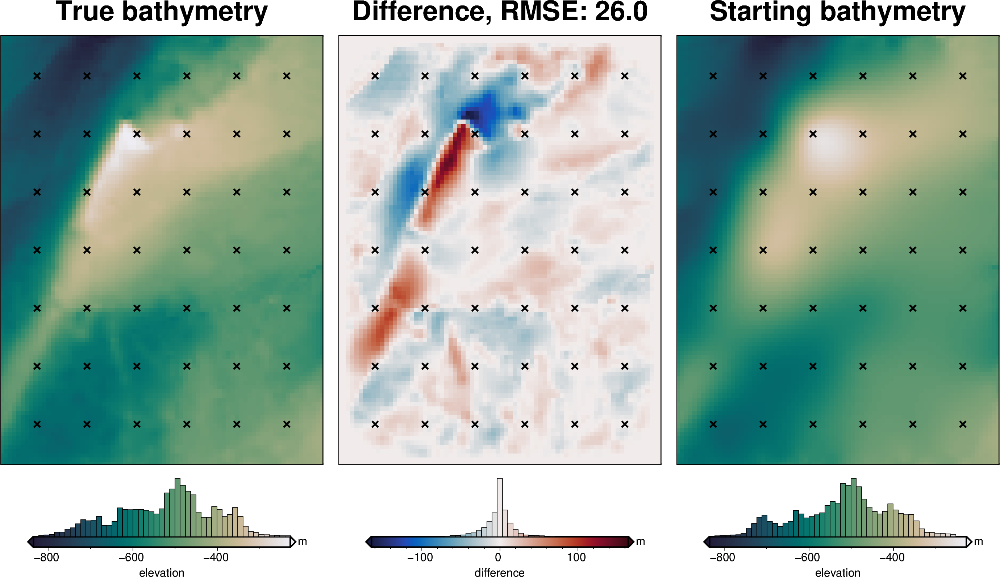

In [15]:
# compare starting and actual bathymetry grids
grids = polar_utils.grd_compare(
    bathymetry,
    starting_bathymetry,
    fig_height=10,
    plot=True,
    plot_type="pygmt",
    cmap="rain",
    reverse_cpt=True,
    diff_cmap="balance+h0",
    grid1_name="True bathymetry",
    grid2_name="Starting bathymetry",
    title="Difference",
    title_font="18p,Helvetica-Bold,black",
    cbar_unit="m",
    cbar_label="elevation",
    RMSE_decimals=0,
    region=inversion_region,
    inset=False,
    hist=True,
    label_font="16p,Helvetica,black",
    points=constraint_points[constraint_points.inside],
    points_style="x.2c",
)

In [16]:
# the true density contrast is 1476 kg/m3
density_contrast = 1350

# set the reference level from the prisms to 0
zref = 0

density_grid = xr.where(
    starting_bathymetry >= zref,
    density_contrast,
    -density_contrast,
)

# create layer of prisms
starting_prisms = utils.grids_to_prisms(
    starting_bathymetry,
    zref,
    density=density_grid,
)

grav_df["starting_gravity"] = starting_prisms.prism_layer.gravity(
    coordinates=(
        grav_df.easting,
        grav_df.northing,
        grav_df.upward,
    ),
    field="g_z",
    progressbar=True,
)

grav_df

  0%|          | 0/7676 [00:00<?, ?it/s]

,northing,easting,upward,bathymetry_grav,basement_grav_normalized,basement_grav,gravity_anomaly,starting_gravity
0,-1600000.0,-40000.0,1000.0,-35.551041,-0.576200,-36.298936,-71.849978,-32.541358
1,-1600000.0,-38000.0,1000.0,-36.054652,-0.523887,-33.944812,-69.999465,-32.965825
2,-1600000.0,-36000.0,1000.0,-36.473148,-0.467097,-31.389260,-67.862409,-33.347646
3,-1600000.0,-34000.0,1000.0,-36.755612,-0.406792,-28.675560,-65.431172,-33.644493
4,-1600000.0,-32000.0,1000.0,-36.951032,-0.343951,-25.847705,-62.798738,-33.840061
...,...,...,...,...,...,...,...,...
7671,-1400000.0,102000.0,1000.0,-25.760380,0.399106,7.589836,-18.170543,-23.321507
7672,-1400000.0,104000.0,1000.0,-25.911731,0.334770,4.694748,-21.216982,-23.482119
7673,-1400000.0,106000.0,1000.0,-26.033127,0.268772,1.724824,-24.308303,-23.605606
7674,-1400000.0,108000.0,1000.0,-26.122232,0.201841,-1.287092,-27.409324,-23.693176


# Regional misfit

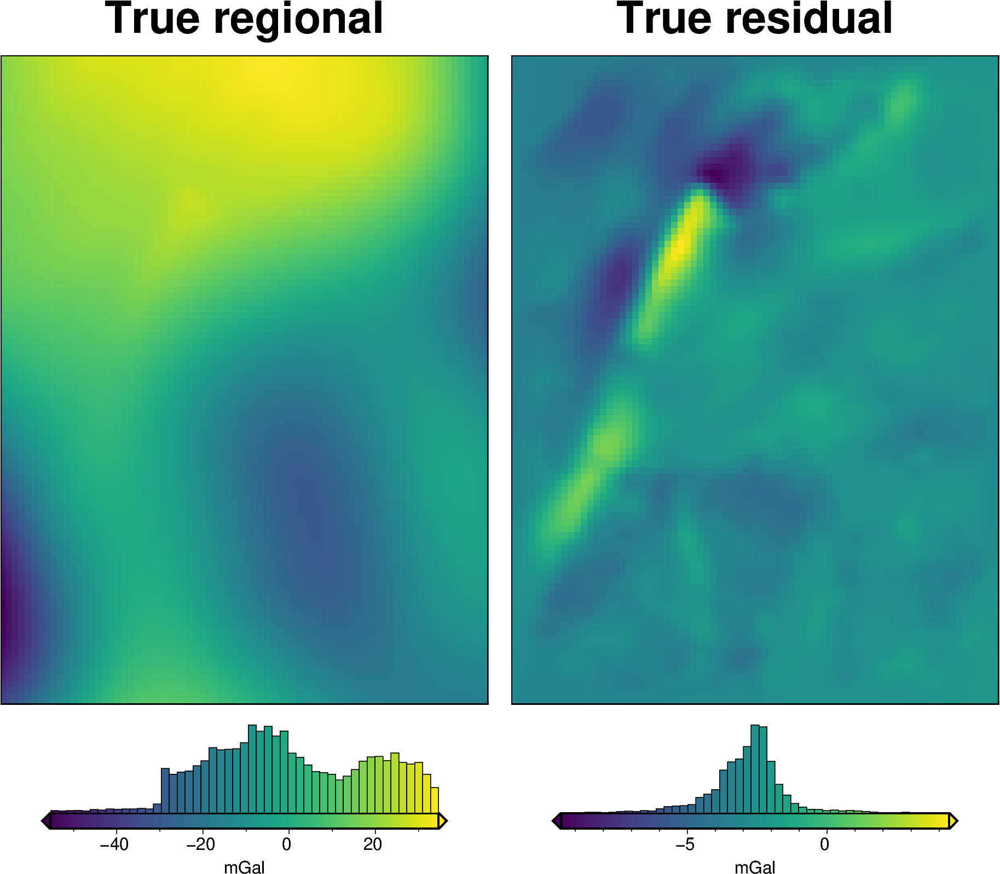

In [17]:
# calculate the true residual misfit
grav_df["true_res"] = grav_df.bathymetry_grav - grav_df.starting_gravity

# grid the results
grav_grid = grav_df.set_index(["northing", "easting"]).to_xarray()

fig = maps.plot_grd(
    grav_grid.basement_grav,
    fig_height=10,
    title="True regional",
    hist=True,
    cbar_label="mGal",
)

fig = maps.plot_grd(
    grav_grid.true_res,
    fig=fig,
    origin_shift="xshift",
    fig_height=10,
    title="True residual",
    hist=True,
    cbar_label="mGal",
)

fig.show()

In [18]:
def regional_comparison(df):
    # grid the results
    grav_grid = df.set_index(["northing", "easting"]).to_xarray()

    # calculate the true residual and regional misfit
    grav_grid["true_res"] = grav_grid.bathymetry_grav - grav_grid.starting_gravity
    # grav_grid["true_reg"] = grav_grid.gravity_anomaly - grav_grid.bathymetry_grav
    grav_grid["true_reg"] = grav_grid.basement_grav

    # compare with true regional
    _ = polar_utils.grd_compare(
        grav_grid.true_reg-(grav_grid.true_reg.mean()-grav_grid.reg.mean()),
        grav_grid.reg,
        plot=True,
        grid1_name="True regional misfit",
        grid2_name="Regional misfit",
        hist=True,
        inset=False,
        verbose="q",
        title="difference",
        grounding_line=False,
        points=constraint_points,
        points_style="x.3c",
    )
    # compare with true residual
    _ = polar_utils.grd_compare(
        grav_grid.true_res-(grav_grid.true_res.mean()-grav_grid.res.mean()),
        grav_grid.res,
        plot=True,
        grid1_name="True residual misfit",
        grid2_name="Residual misfit",
        cmap="balance+h0",
        hist=True,
        inset=False,
        verbose="q",
        title="difference",
        grounding_line=False,
        points=constraint_points,
        points_style="x.3c",
    )

In [19]:
# estimate regional with the mean misfit at constraints
regional_grav_kwargs = dict(
    method="constraints",
    grid_method="eq_sources",
    constraints_df=constraint_points,
    cv=True,
    cv_kwargs=dict(
        n_trials=20,
        # damping_limits=(1e-30, 10),
        depth_limits=(100, 400e3),
        progressbar=False,
        fname="../tmp_outputs/Ross_Sea_04_regional_sep",
    ),
    block_size=None,
    damping=None,
)
# regional_grav_kwargs = dict(
#     method="constraints",
#     grid_method="pygmt",
#     constraints_df=constraint_points,
#     tension_factor=1,
# )

INFO:invert4geom:using 5 startup trials


  0%|          | 0/5 [00:00<?, ?it/s]

  0%|          | 0/15 [00:00<?, ?it/s]

INFO:invert4geom:Trial with best score: 
INFO:invert4geom:	trial number: 14
INFO:invert4geom:	parameter: {'depth': 301265.54121376434}
INFO:invert4geom:	scores: [0.9996811605322649]


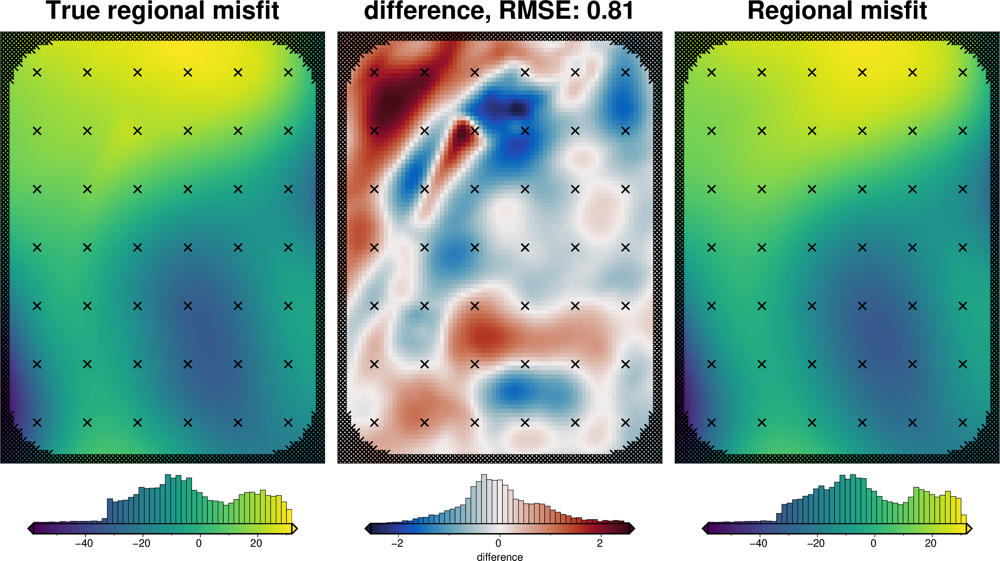

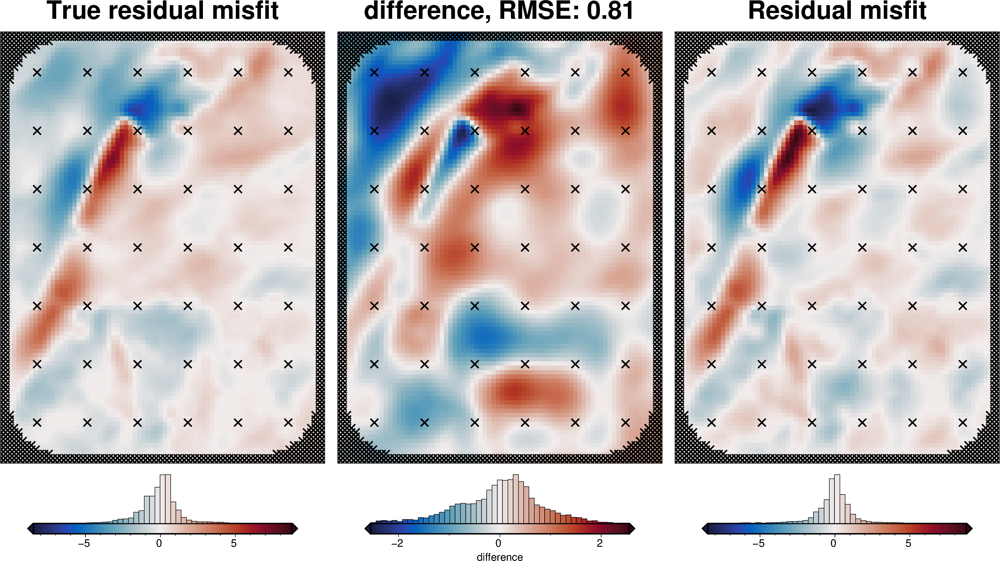

,northing,easting,upward,bathymetry_grav,basement_grav_normalized,basement_grav,gravity_anomaly,starting_gravity,true_res,misfit,reg,res
count,7.676000e+03,7676.000000,7676.0,7676.000000,7676.000000,7.676000e+03,7676.000000,7676.000000,7676.000000,7676.000000,7676.000000,7676.000000
mean,-1.500000e+06,35000.000000,1000.0,-31.727297,0.230443,-1.895768e-15,-31.727297,-28.869499,-2.857798,-2.857798,-2.759685,-0.098114
std,5.831332e+04,43877.680138,0.0,6.458138,0.409159,1.841213e+01,18.716724,5.735683,1.373350,18.214644,18.317836,1.542381
min,-1.600000e+06,-40000.000000,1000.0,-48.457766,-1.000000,-5.536992e+01,-86.229126,-44.455616,-9.507991,-58.117307,-58.089966,-8.469335
25%,-1.550000e+06,-2500.000000,1000.0,-36.286368,-0.074669,-1.373002e+01,-44.467648,-32.676763,-3.516023,-16.422771,-16.448608,-0.565786
50%,-1.500000e+06,35000.000000,1000.0,-31.030073,0.181261,-2.213188e+00,-34.790730,-28.426810,-2.725042,-5.021662,-4.867004,-0.011696
75%,-1.450000e+06,72500.000000,1000.0,-27.279068,0.595978,1.644907e+01,-18.693374,-24.769772,-2.210145,13.400250,13.711975,0.485911
max,-1.400000e+06,110000.000000,1000.0,-16.585801,1.000000,3.463008e+01,9.252252,-15.540470,4.358573,32.437269,31.262085,8.766966


In [20]:
temp_reg_kwargs = copy.deepcopy(regional_grav_kwargs)

# temporarily set some kwargs
temp_reg_kwargs["cv_kwargs"]["plot"] = True
temp_reg_kwargs["cv_kwargs"]["progressbar"] = True

grav_df = regional.regional_separation(
    grav_df=grav_df,
    **temp_reg_kwargs,
)

regional_comparison(grav_df)
grav_df.describe()

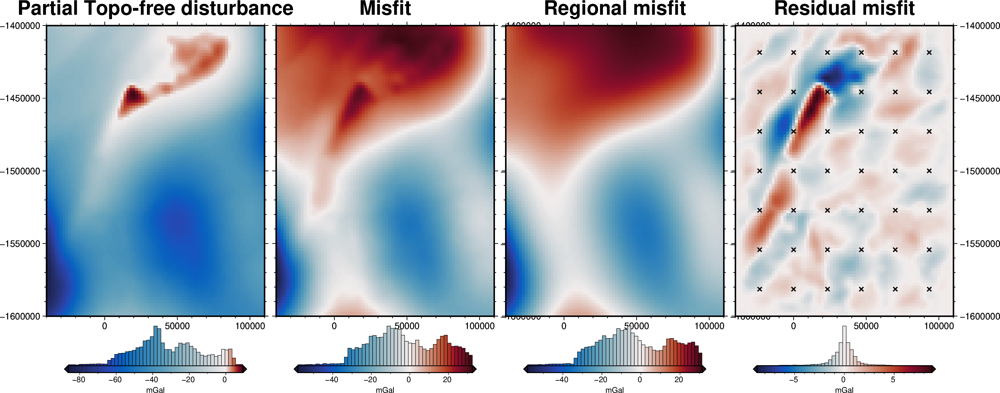

In [21]:
grav_grid = grav_df.set_index(["northing", "easting"]).to_xarray()

fig = maps.plot_grd(
    grav_grid.gravity_anomaly,
    region=inversion_region,
    fig_height=10,
    title="Partial Topo-free disturbance",
    cmap="balance+h0",
    hist=True,
    cbar_label="mGal",
    frame=["nSWe", "xaf10000", "yaf10000"],
)

fig = maps.plot_grd(
    grav_grid.misfit,
    region=inversion_region,
    fig=fig,
    origin_shift="xshift",
    fig_height=10,
    title="Misfit",
    cmap="balance+h0",
    hist=True,
    cbar_label="mGal",
    frame=["nSwE", "xaf10000", "yaf10000"],
)

fig = maps.plot_grd(
    grav_grid.reg,
    region=inversion_region,
    fig=fig,
    origin_shift="xshift",
    fig_height=10,
    title="Regional misfit",
    cmap="balance+h0",
    hist=True,
    cbar_label="mGal",
    frame=["nSwE", "xaf10000", "yaf10000"],
)

fig = maps.plot_grd(
    grav_grid.res,
    region=inversion_region,
    fig=fig,
    origin_shift="xshift",
    fig_height=10,
    title="Residual misfit",
    cmap="balance+h0",
    cpt_lims=[-vd.maxabs(grav_grid.res), vd.maxabs(grav_grid.res)],
    hist=True,
    cbar_label="mGal",
    frame=["nSwE", "xaf10000", "yaf10000"],
    points=constraint_points[constraint_points.inside],
    points_style="x.2c",
)
fig.show()

In [22]:
# set kwargs to pass to the inversion
kwargs = {
    # set stopping criteria
    "max_iterations": 200,
    "l2_norm_tolerance": 0.2**0.5,  # square root of the gravity noise
    "delta_l2_norm_tolerance": 1.008,
}

# Damping Cross Validation

In [23]:
logging.getLogger().setLevel(logging.INFO)

# run the inversion workflow, including a cross validation for the damping parameter
results = inversion.run_inversion_workflow(
    grav_df=grav_df,
    starting_prisms=starting_prisms,
    # for creating test/train splits
    grav_spacing=spacing,
    inversion_region=inversion_region,
    run_damping_cv=True,
    damping_limits=(0.001, 0.1),
    damping_cv_trials=8,
    # plot_cv=True,
    fname=f"{fpath}_damping_cv",
    **kwargs,
)

INFO:invert4geom:saving all results with root name '../results/Ross_Sea/Ross_Sea_04_damping_cv'
INFO:invert4geom:running damping cross validation
INFO:invert4geom:using 4 startup trials


  0%|          | 0/4 [00:00<?, ?it/s]

  0%|          | 0/4 [00:00<?, ?it/s]

INFO:invert4geom:Trial with best score: 
INFO:invert4geom:	trial number: 5
INFO:invert4geom:	parameter: {'damping': 0.01343800976396253}
INFO:invert4geom:	scores: [0.016500718757461966]
INFO:invert4geom:results saved to ../results/Ross_Sea/Ross_Sea_04_damping_cv_results.pickle.pickle


In [24]:
# load saved inversion results
with pathlib.Path(f"{fpath}_damping_cv_results.pickle").open(
    "rb"
) as f:
    results = pickle.load(f)

# load study
with pathlib.Path(f"{fpath}_damping_cv_damping_cv_study.pickle").open(
    "rb"
) as f:
    study = pickle.load(f)

# collect the results
topo_results, grav_results, parameters, elapsed_time = results

In [25]:
best_damping = parameters.get("Solver damping")
kwargs["solver_damping"] = best_damping
best_damping

0.01343800976396253

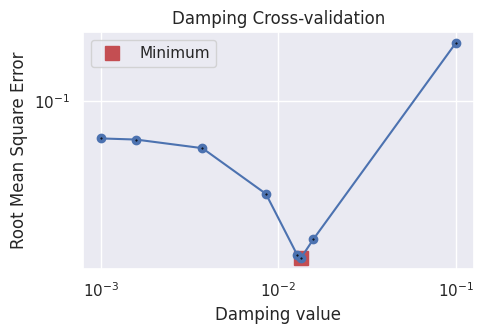

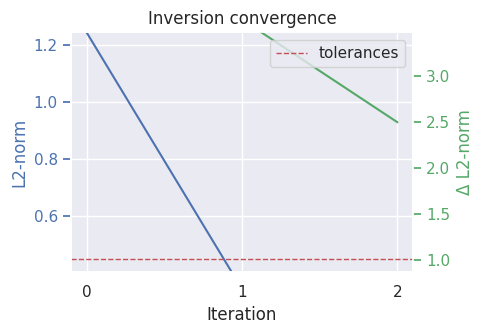

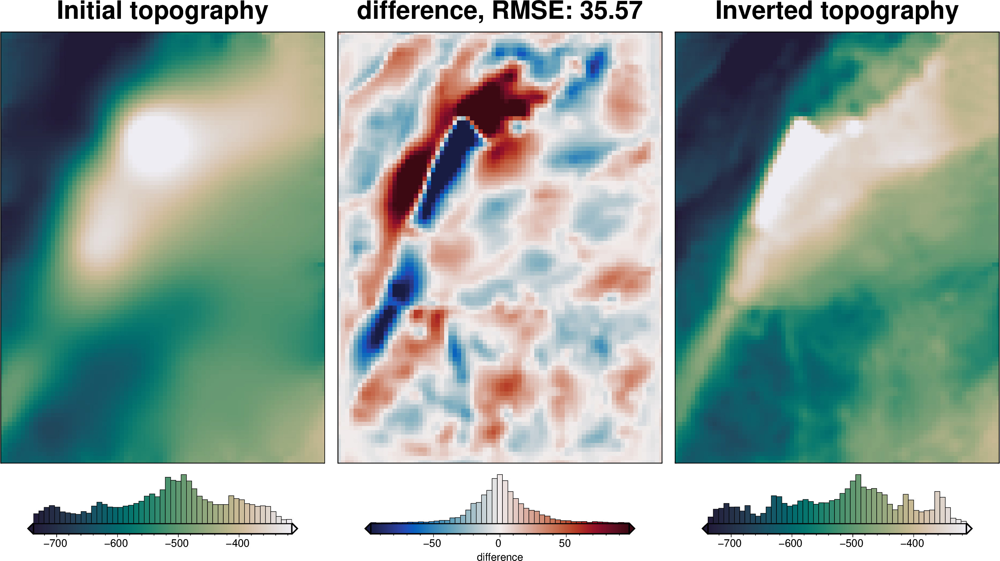

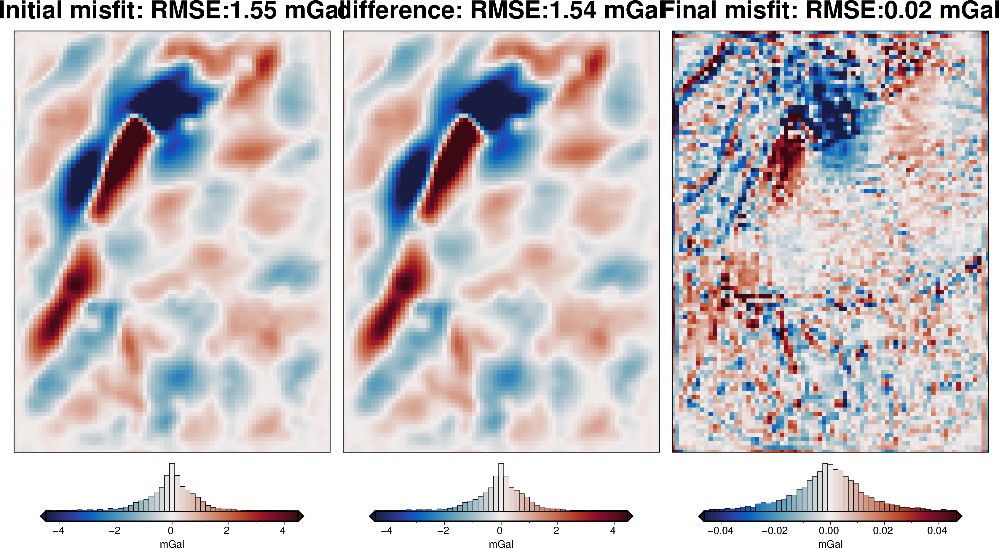

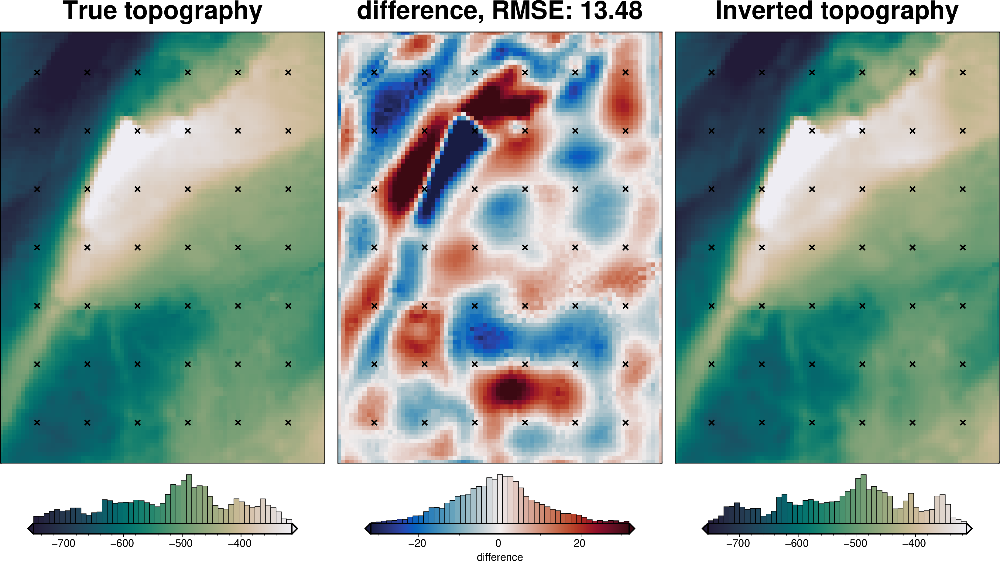

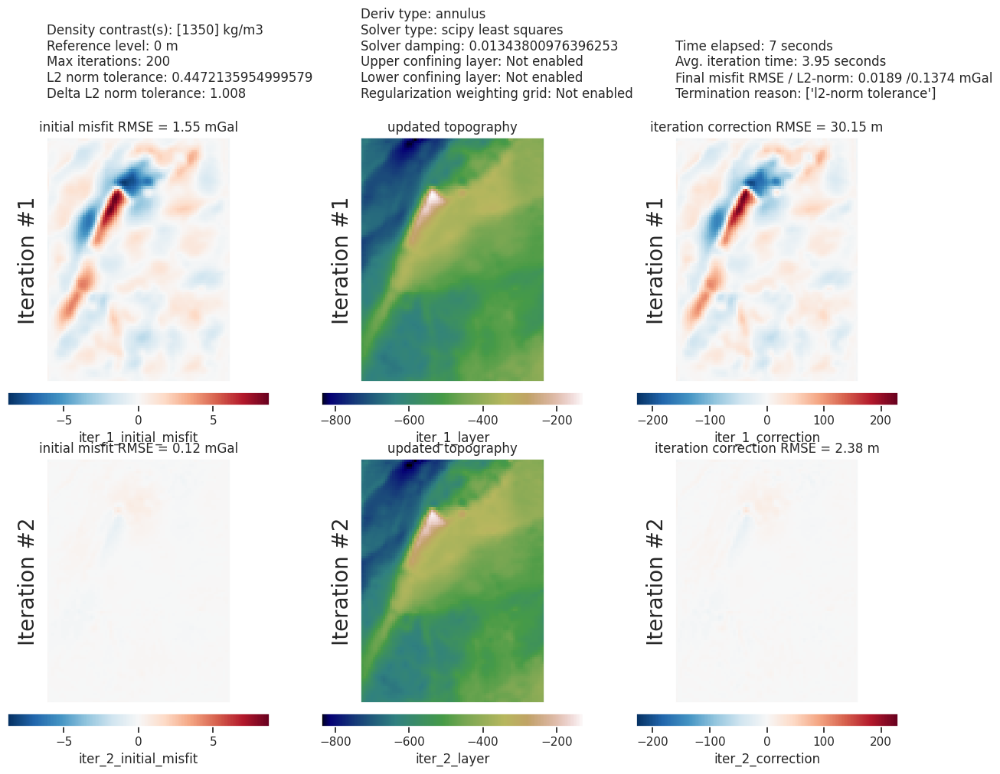

In [26]:
study_df = study.trials_dataframe()

plotting.plot_cv_scores(
    study_df.value,
    study_df.params_damping,
    param_name="Damping",
    logx=True,
    logy=True,
)

plotting.plot_convergence(
    grav_results,
    params=parameters,
)

plotting.plot_inversion_results(
    grav_results,
    topo_results,
    parameters,
    inversion_region,
    iters_to_plot=2,
    plot_iter_results=True,
    plot_topo_results=True,
    plot_grav_results=True,
)

final_topography = topo_results.set_index(["northing", "easting"]).to_xarray().topo

_ = polar_utils.grd_compare(
    bathymetry,
    final_topography,
    region=inversion_region,
    plot=True,
    grid1_name="True topography",
    grid2_name="Inverted topography",
    robust=True,
    hist=True,
    inset=False,
    verbose="q",
    title="difference",
    grounding_line=False,
    reverse_cpt=True,
    cmap="rain",
    points=constraint_points[constraint_points.inside],
    points_style="x.2c",
)

In [27]:
# sample the inverted topography at the constraint points
constraint_points = utils.sample_grids(
    constraint_points,
    final_topography,
    "inverted_topography",
    coord_names=("easting", "northing"),
)

rmse = utils.rmse(constraint_points.upward - constraint_points.inverted_topography)
print(f"RMSE: {rmse:.2f} m")

RMSE: 6.13 m


# Density CV

INFO:invert4geom:using 4 startup trials


  0%|          | 0/4 [00:00<?, ?it/s]

  0%|          | 0/4 [00:00<?, ?it/s]

INFO:invert4geom:Trial with best score: 
INFO:invert4geom:	trial number: 6
INFO:invert4geom:	parameter: {'density_contrast': 2294}
INFO:invert4geom:	scores: [375.6610639654745]


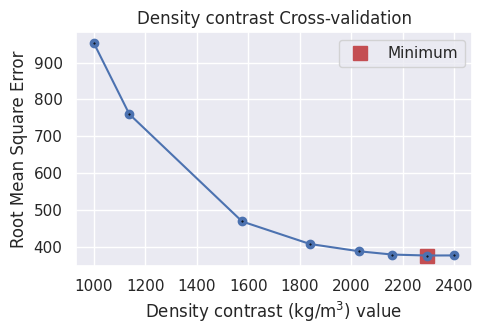

In [28]:
# run the cross validation for density
study, inversion_results = optimization.optimize_inversion_zref_density_contrast(
    grav_df=grav_df,
    constraints_df=constraint_points,  # [constraint_points.inside],
    density_contrast_limits=(1000, 2400),
    zref=0,
    n_trials=8,
    starting_topography=starting_bathymetry,
    regional_grav_kwargs=dict(
        method="constant",
        constant=0,
    ),
    fname=f"{fpath}_density_cv",
    **kwargs,
)

INFO:invert4geom:Constraints split into 4 folds
INFO:invert4geom:using 4 startup trials


  0%|          | 0/4 [00:00<?, ?it/s]

INFO:invert4geom:starting_topography not provided, creating a starting topography model with the supplied starting_topography_kwargs


  0%|          | 0/8 [00:00<?, ?it/s]

INFO:invert4geom:starting_topography not provided, creating a starting topography model with the supplied starting_topography_kwargs
INFO:invert4geom:Trial with best score: 
INFO:invert4geom:	trial number: 8
INFO:invert4geom:	parameter: {'density_contrast': 2099}
INFO:invert4geom:	scores: [36.50586999555323]


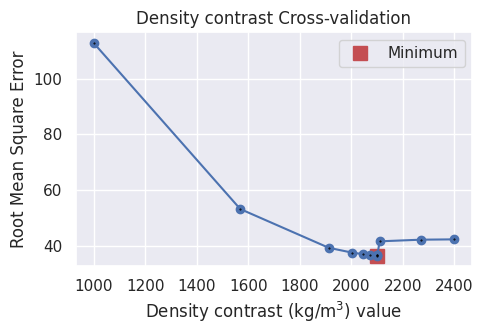

In [29]:
# run a 5-fold cross validation for 10 parameter sets of density
# this performs 50 regional separations and 50 inversions
study, inversion_results = optimization.optimize_inversion_zref_density_contrast_kfolds(
    grav_df=grav_df,
    constraints_df=constraint_points[constraint_points.inside],
    density_contrast_limits=(1000, 2400),
    zref=0,
    n_trials=12,
    # n_startup_trials=6,
    split_kwargs=dict(
        n_splits=4,
        method="KFold",
        # shape=(10,10),
    ),
    seed=2,
    # score_as_median=True,
    regional_grav_kwargs=regional_grav_kwargs,
    starting_topography_kwargs=starting_topography_kwargs,
    fname=f"{fpath}_density_cv_kfolds",
    fold_progressbar=False,
    **kwargs,
)

In [30]:
# load study from normal optimization
with pathlib.Path(f"{fpath}_density_cv_study.pickle").open("rb") as f:
    study = pickle.load(f)
    optimized_density = study.best_params["density_contrast"]

# load study from kfold optimization
with pathlib.Path(f"{fpath}_density_cv_kfolds_study.pickle").open(
    "rb"
) as f:
    study = pickle.load(f)
    kfold_optimized_density = study.best_params["density_contrast"]

print("optimal density contrast from normal optimization: ", optimized_density)
print("optimal density contrast from K-folds optimization: ", kfold_optimized_density)
print("real density contrast", true_density_contrast)

best_density_contrast = min(
    [optimized_density, kfold_optimized_density],
    key=lambda x: abs(x - true_density_contrast),
)

optimal density contrast from normal optimization:  2294
optimal density contrast from K-folds optimization:  2099
real density contrast 1476


In [31]:
print("optimal determined density contrast", best_density_contrast)
print("real density contrast", true_density_contrast)
print("density error", best_density_contrast - true_density_contrast)

optimal determined density contrast 2099
real density contrast 1476
density error 623


### Redo with optimal density contrast
During the density cross-validation to avoid biasing the scores, we had to manually set a regional field. Now, with the optimal density contrast value found, we can rerun the inversion with an automatically determined regional field strength (the average value misfit at the constraints).

  0%|          | 0/7676 [00:00<?, ?it/s]

INFO:invert4geom:using 5 startup trials
INFO:invert4geom:Trial with best score: 
INFO:invert4geom:	trial number: 7
INFO:invert4geom:	parameter: {'depth': 281862.9250746396}
INFO:invert4geom:	scores: [0.9998444133532285]


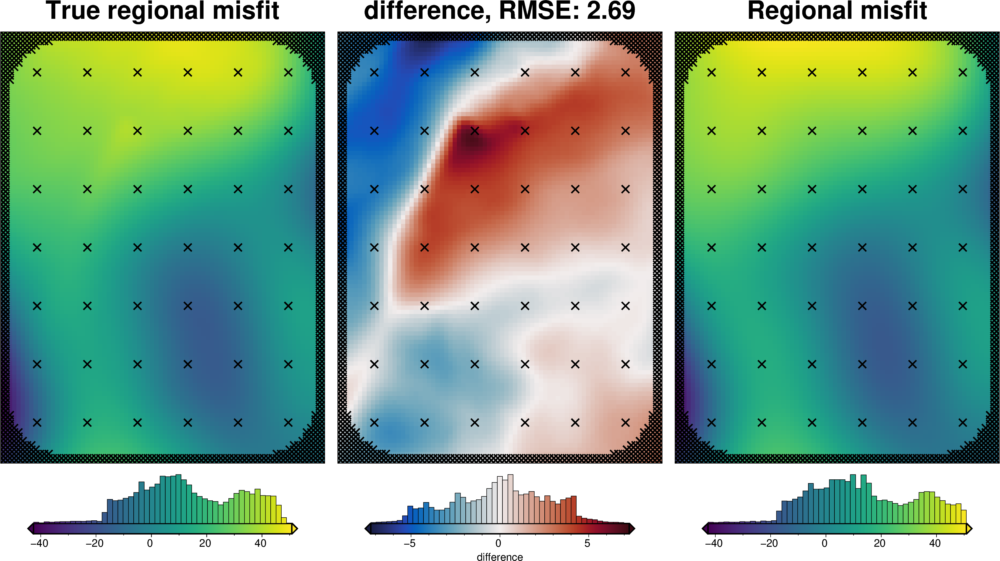

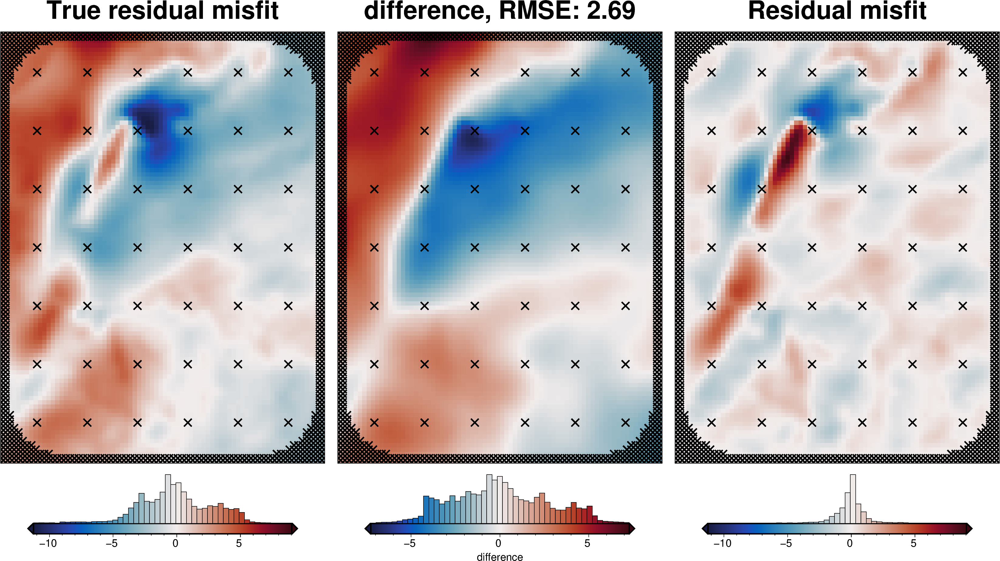

In [32]:
density_contrast = best_density_contrast

density_grid = xr.where(
    starting_bathymetry >= zref,
    density_contrast,
    -density_contrast,
)
# create layer of prisms
starting_prisms = utils.grids_to_prisms(
    starting_bathymetry,
    zref,
    density=density_grid,
)
grav_df["starting_gravity"] = starting_prisms.prism_layer.gravity(
    coordinates=(
        grav_df.easting,
        grav_df.northing,
        grav_df.upward,
    ),
    field="g_z",
    progressbar=True,
)

grav_df = regional.regional_separation(
    grav_df=grav_df,
    **regional_grav_kwargs,
)

regional_comparison(grav_df)

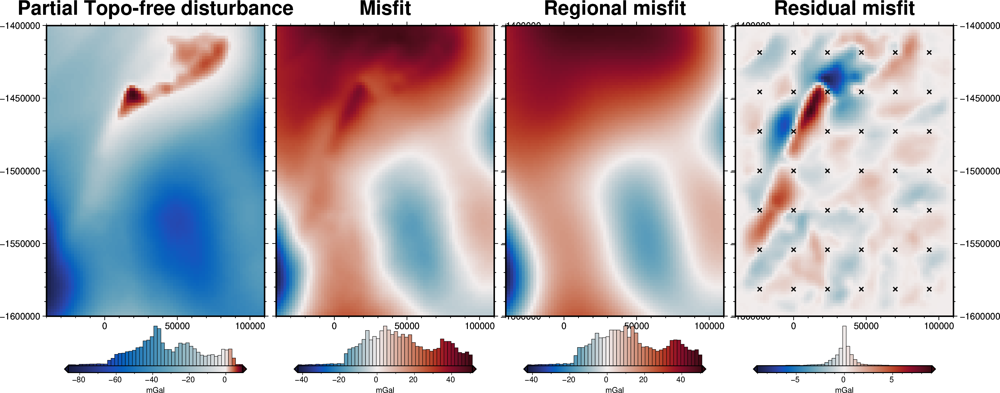

In [33]:
grav_grid = grav_df.set_index(["northing", "easting"]).to_xarray()

fig = maps.plot_grd(
    grav_grid.gravity_anomaly,
    region=inversion_region,
    fig_height=10,
    title="Partial Topo-free disturbance",
    cmap="balance+h0",
    hist=True,
    cbar_label="mGal",
    frame=["nSWe", "xaf10000", "yaf10000"],
)

fig = maps.plot_grd(
    grav_grid.misfit,
    region=inversion_region,
    fig=fig,
    origin_shift="xshift",
    fig_height=10,
    title="Misfit",
    cmap="balance+h0",
    hist=True,
    cbar_label="mGal",
    frame=["nSwE", "xaf10000", "yaf10000"],
)

fig = maps.plot_grd(
    grav_grid.reg,
    region=inversion_region,
    fig=fig,
    origin_shift="xshift",
    fig_height=10,
    title="Regional misfit",
    cmap="balance+h0",
    hist=True,
    cbar_label="mGal",
    frame=["nSwE", "xaf10000", "yaf10000"],
)

fig = maps.plot_grd(
    grav_grid.res,
    region=inversion_region,
    fig=fig,
    origin_shift="xshift",
    fig_height=10,
    title="Residual misfit",
    cmap="balance+h0",
    cpt_lims=[-vd.maxabs(grav_grid.res), vd.maxabs(grav_grid.res)],
    hist=True,
    cbar_label="mGal",
    frame=["nSwE", "xaf10000", "yaf10000"],
    points=constraint_points[constraint_points.inside],
    points_style="x.2c",
)
fig.show()

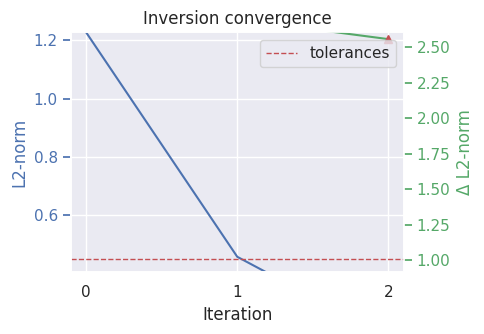

In [34]:
# run the inversion workflow
inversion_results = inversion.run_inversion_workflow(
    grav_df=grav_df,
    fname=f"{fpath}_optimal",
    starting_prisms=starting_prisms,
    plot_dynamic_convergence=True,
    **kwargs,
)

In [35]:
# load saved inversion results
with pathlib.Path(f"{fpath}_optimal_results.pickle").open("rb") as f:
    results = pickle.load(f)

# collect the results
topo_results, grav_results, parameters, elapsed_time = results

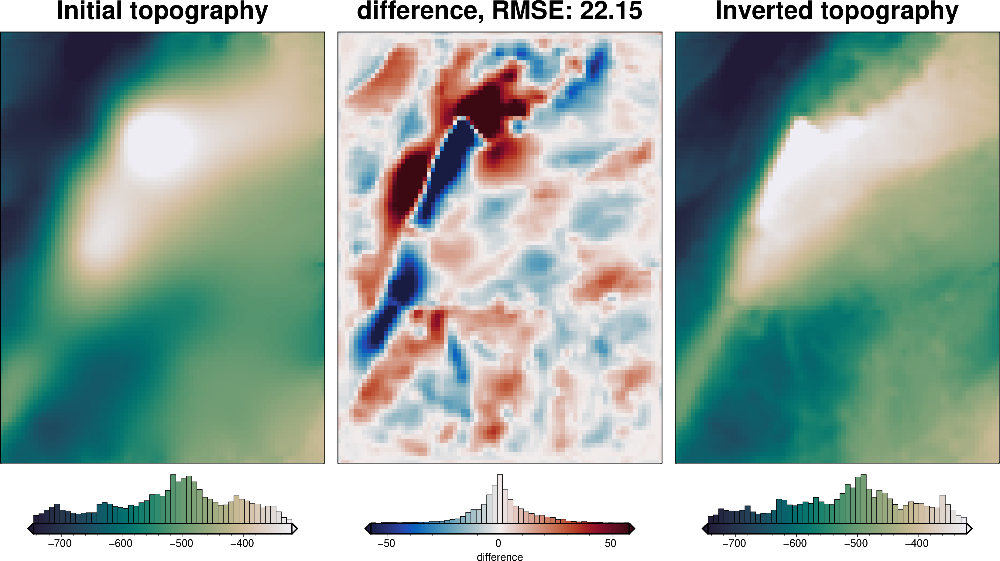

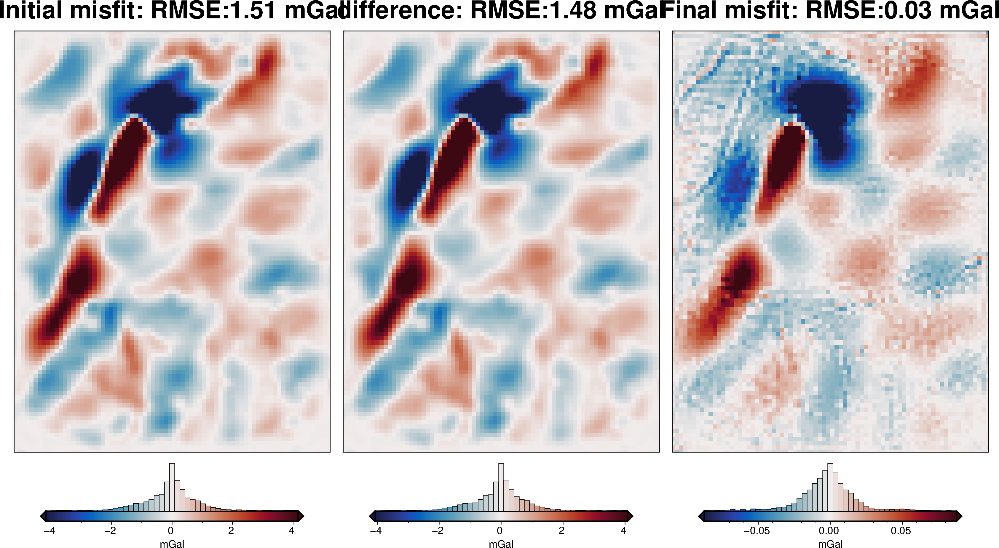

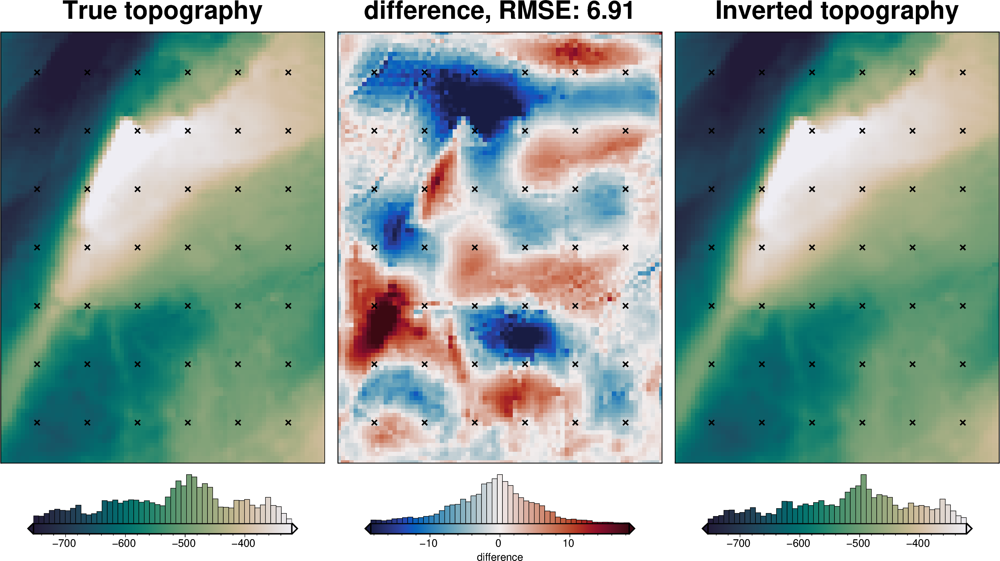

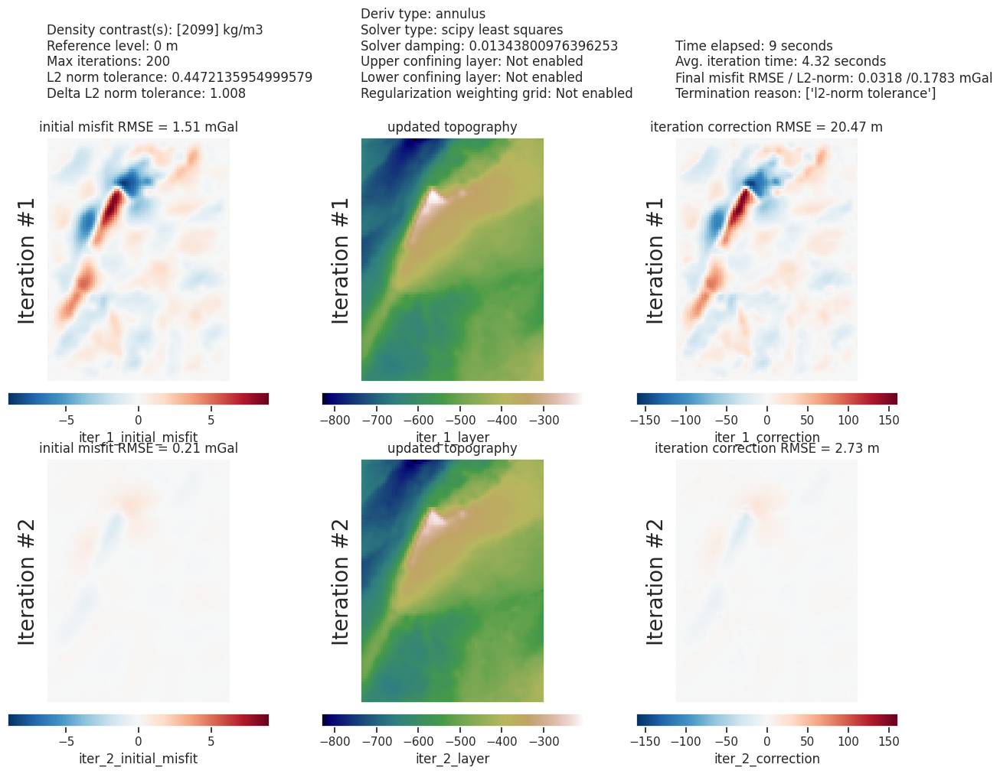

In [36]:
plotting.plot_inversion_results(
    grav_results,
    topo_results,
    parameters,
    inversion_region,
    iters_to_plot=2,
    plot_iter_results=True,
    plot_topo_results=True,
    plot_grav_results=True,
)

final_topography = topo_results.set_index(["northing", "easting"]).to_xarray().topo

_ = polar_utils.grd_compare(
    bathymetry,
    final_topography,
    region=inversion_region,
    plot=True,
    grid1_name="True topography",
    grid2_name="Inverted topography",
    robust=True,
    hist=True,
    inset=False,
    verbose="q",
    title="difference",
    grounding_line=False,
    reverse_cpt=True,
    cmap="rain",
    points=constraint_points[constraint_points.inside],
    points_style="x.2c",
)

In [37]:
# sample the inverted topography at the constraint points
constraint_points = utils.sample_grids(
    constraint_points,
    final_topography,
    "inverted_topography",
    coord_names=("easting", "northing"),
)

rmse = utils.rmse(constraint_points.upward - constraint_points.inverted_topography)
print(f"RMSE: {rmse:.2f} m")

RMSE: 2.55 m


In [38]:
# save to csv
constraint_points.to_csv(f"{fpath}_constraint_points.csv", index=False)

# Redo regional separation with true density

  0%|          | 0/7676 [00:00<?, ?it/s]

INFO:invert4geom:using 5 startup trials


  0%|          | 0/5 [00:00<?, ?it/s]

  0%|          | 0/15 [00:00<?, ?it/s]

INFO:invert4geom:Trial with best score: 
INFO:invert4geom:	trial number: 18
INFO:invert4geom:	parameter: {'depth': 291150.8151493291}
INFO:invert4geom:	scores: [0.9997263982833028]


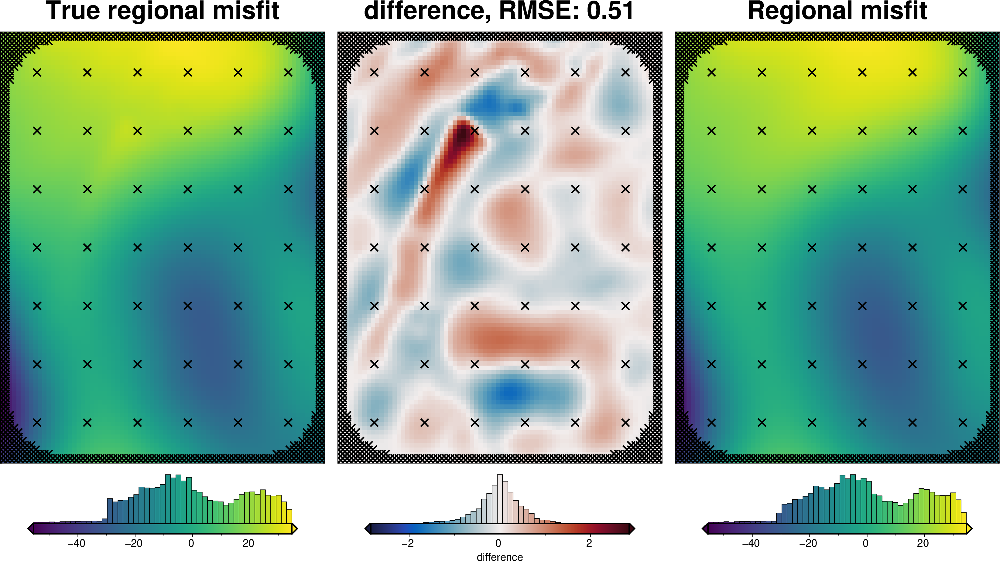

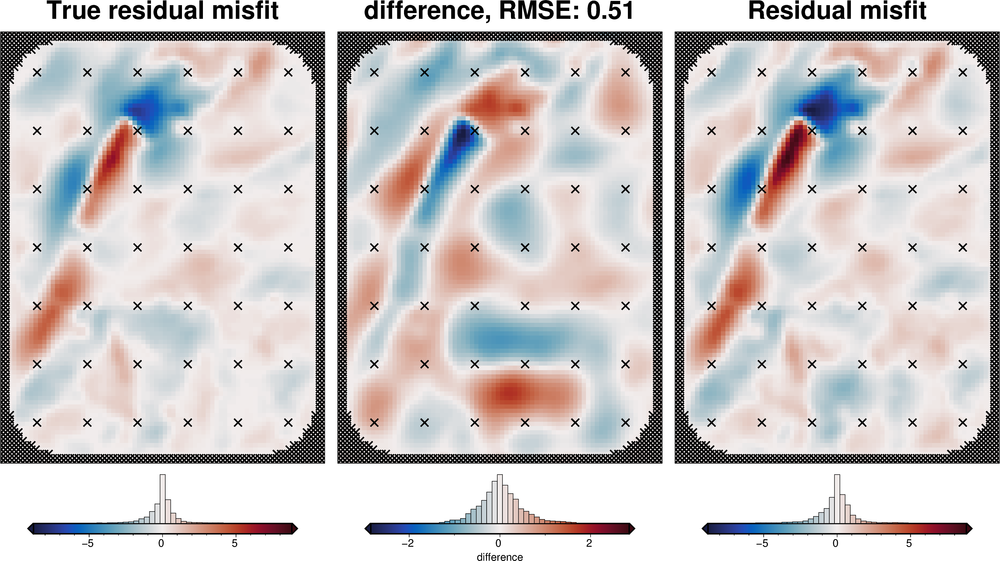

In [84]:
density_grid = xr.where(
    starting_bathymetry >= zref,
    true_density_contrast,
    -true_density_contrast,
)
# create layer of prisms
starting_prisms_true = utils.grids_to_prisms(
    starting_bathymetry,
    zref,
    density=density_grid,
)

grav_df_true_density = grav_df.copy()

grav_df_true_density["starting_gravity"] = starting_prisms_true.prism_layer.gravity(
    coordinates=(
        grav_df_true_density.easting,
        grav_df_true_density.northing,
        grav_df_true_density.upward,
    ),
    field="g_z",
    progressbar=True,
)

# temporarily set some kwargs
true_density_reg_kwargs = copy.deepcopy(regional_grav_kwargs)
true_density_reg_kwargs["cv_kwargs"]["fname"] = "../tmp_outputs/Ross_Sea_04_regional_sep_true_density"
true_density_reg_kwargs["cv_kwargs"]["progressbar"] = True

grav_df_true_density = regional.regional_separation(
    grav_df=grav_df_true_density,
    **true_density_reg_kwargs,
)

regional_comparison(grav_df_true_density)

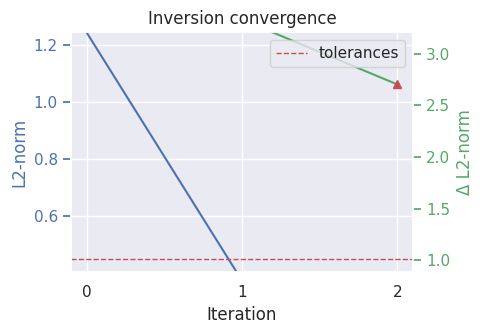

In [85]:
# run the inversion workflow
inversion_results = inversion.run_inversion_workflow(
    grav_df=grav_df_true_density,
    fname=f"{fpath}_true_density",
    starting_prisms=starting_prisms_true,
    plot_dynamic_convergence=True,
    **kwargs,
)

In [86]:
# load saved inversion results
with pathlib.Path(f"{fpath}_true_density_results.pickle").open("rb") as f:
    inversion_results = pickle.load(f)

# collect the results
topo_results, grav_results, parameters, elapsed_time = inversion_results

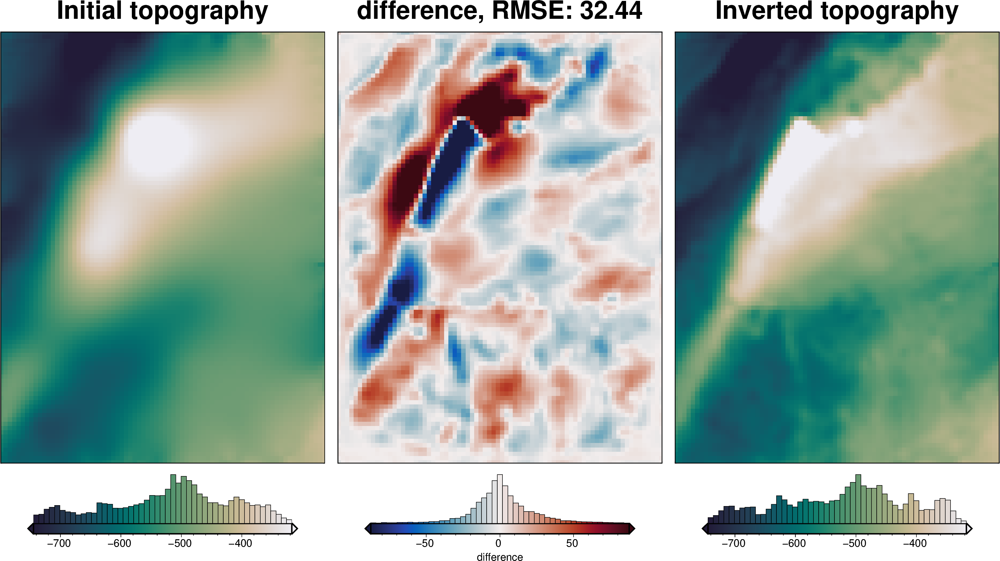

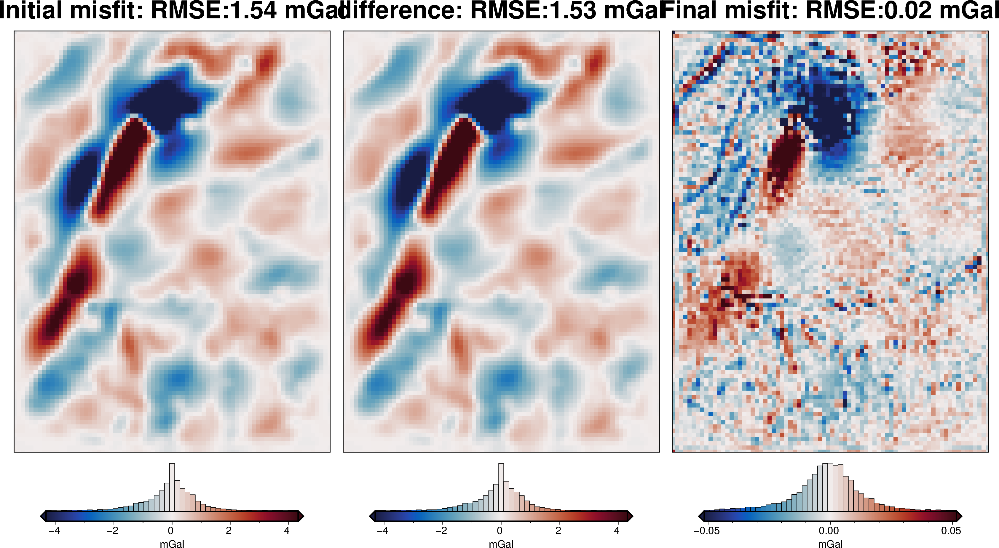

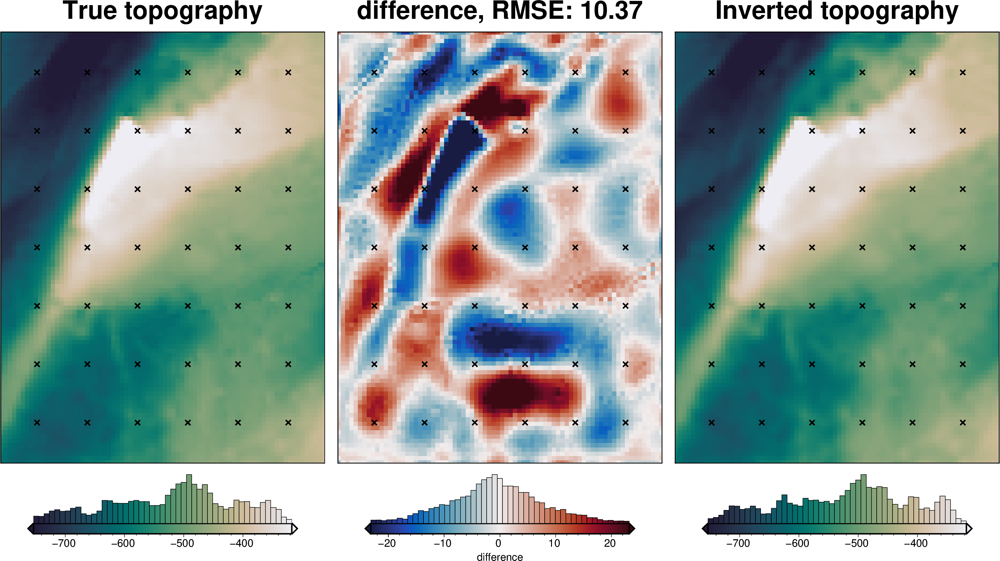

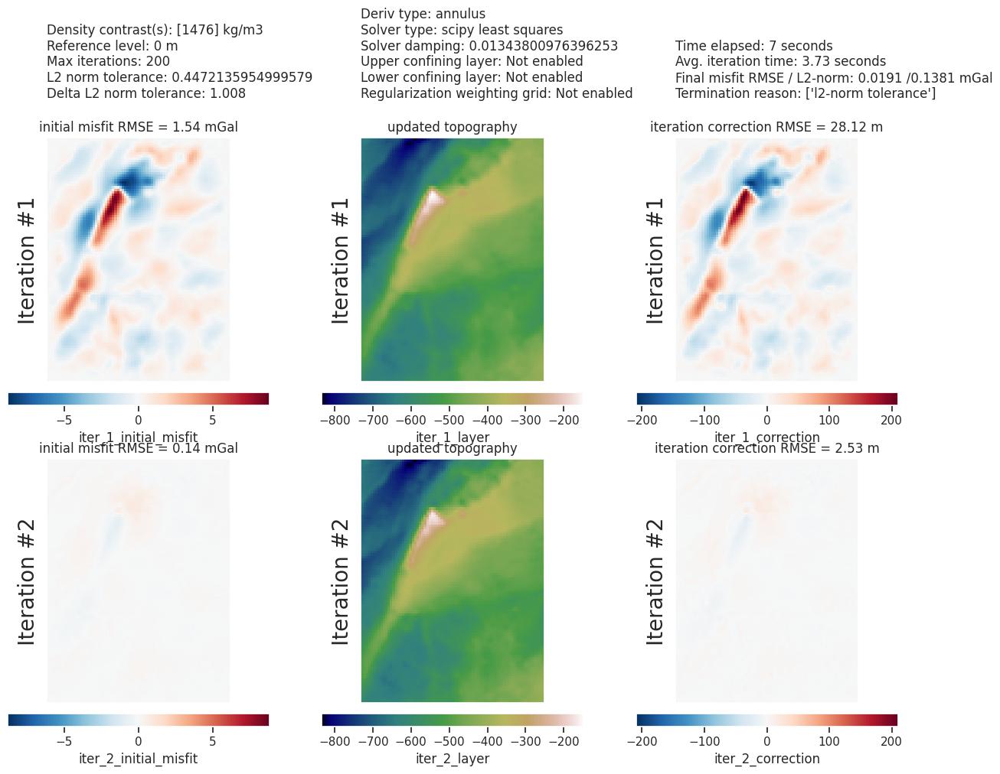

In [87]:
plotting.plot_inversion_results(
    grav_results,
    topo_results,
    parameters,
    inversion_region,
    iters_to_plot=2,
    plot_iter_results=True,
    plot_topo_results=True,
    plot_grav_results=True,
)

final_topography = topo_results.set_index(["northing", "easting"]).to_xarray().topo

_ = polar_utils.grd_compare(
    bathymetry,
    final_topography,
    region=inversion_region,
    plot=True,
    grid1_name="True topography",
    grid2_name="Inverted topography",
    robust=True,
    hist=True,
    inset=False,
    verbose="q",
    title="difference",
    grounding_line=False,
    reverse_cpt=True,
    cmap="rain",
    points=constraint_points[constraint_points.inside],
    points_style="x.2c",
)

In [43]:
# re-load the study from the saved pickle file
with pathlib.Path(f"{true_density_reg_kwargs.get('cv_kwargs').get('fname')}.pickle").open(
    "rb"
) as f:
    study = pickle.load(f)
reg_eq_depth = min(study.best_trials, key=lambda t: t.values[0]).params["depth"]
# reg_eq_damping = min(study.best_trials, key=lambda t: t.values[0]).params["damping"]
reg_eq_damping = None

new_true_density_reg_kwargs = dict(
    method="constraints",
    grid_method="eq_sources",
    constraints_df=constraint_points,
    damping=reg_eq_damping,
    depth=reg_eq_depth,
    block_size=None,
)
reg_eq_depth, reg_eq_damping

(291150.8151493291, None)

In [44]:
grav_df_true_density

,northing,easting,upward,bathymetry_grav,basement_grav_normalized,basement_grav,gravity_anomaly,starting_gravity,true_res,misfit,reg,res
0,-1600000.0,-40000.0,1000.0,-35.551041,-0.576200,-36.298936,-71.849978,-35.578552,-3.009683,-36.271426,-36.368591,0.097165
1,-1600000.0,-38000.0,1000.0,-36.054652,-0.523887,-33.944812,-69.999465,-36.042636,-3.088827,-33.956829,-33.947937,-0.008892
2,-1600000.0,-36000.0,1000.0,-36.473148,-0.467097,-31.389260,-67.862409,-36.460093,-3.125503,-31.402316,-31.353333,-0.048984
3,-1600000.0,-34000.0,1000.0,-36.755612,-0.406792,-28.675560,-65.431172,-36.784646,-3.111119,-28.646526,-28.625488,-0.021038
4,-1600000.0,-32000.0,1000.0,-36.951032,-0.343951,-25.847705,-62.798738,-36.998466,-3.110972,-25.800271,-25.799377,-0.000894
...,...,...,...,...,...,...,...,...,...,...,...,...
7671,-1400000.0,102000.0,1000.0,-25.760380,0.399106,7.589836,-18.170543,-25.498181,-2.438873,7.327637,7.342407,-0.014770
7672,-1400000.0,104000.0,1000.0,-25.911731,0.334770,4.694748,-21.216982,-25.673783,-2.429612,4.456801,4.434082,0.022719
7673,-1400000.0,106000.0,1000.0,-26.033127,0.268772,1.724824,-24.308303,-25.808796,-2.427521,1.500493,1.426880,0.073614
7674,-1400000.0,108000.0,1000.0,-26.122232,0.201841,-1.287092,-27.409324,-25.904539,-2.429056,-1.504784,-1.613159,0.108375


INFO:invert4geom:Sampled 'depth' parameter values; mean: 291150.8151493291, min: 148489.5372087881, max: 433812.0930898702


starting regional ensemble:   0%|          | 0/20 [00:00<?, ?it/s]

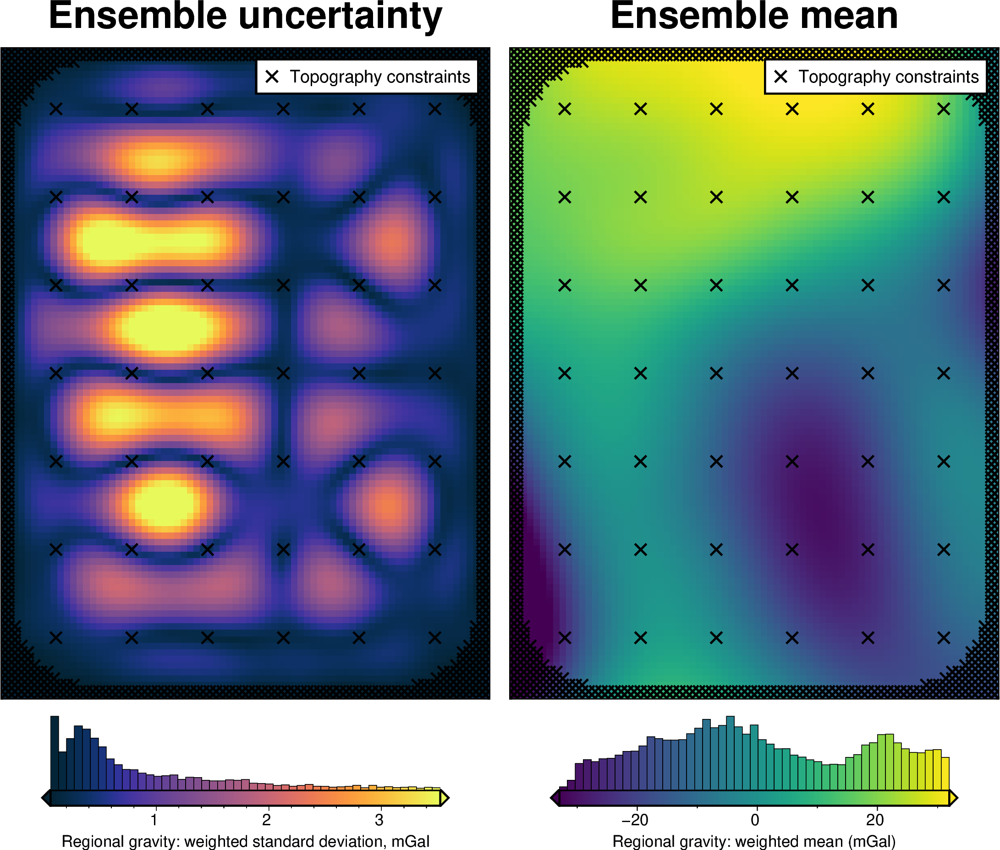

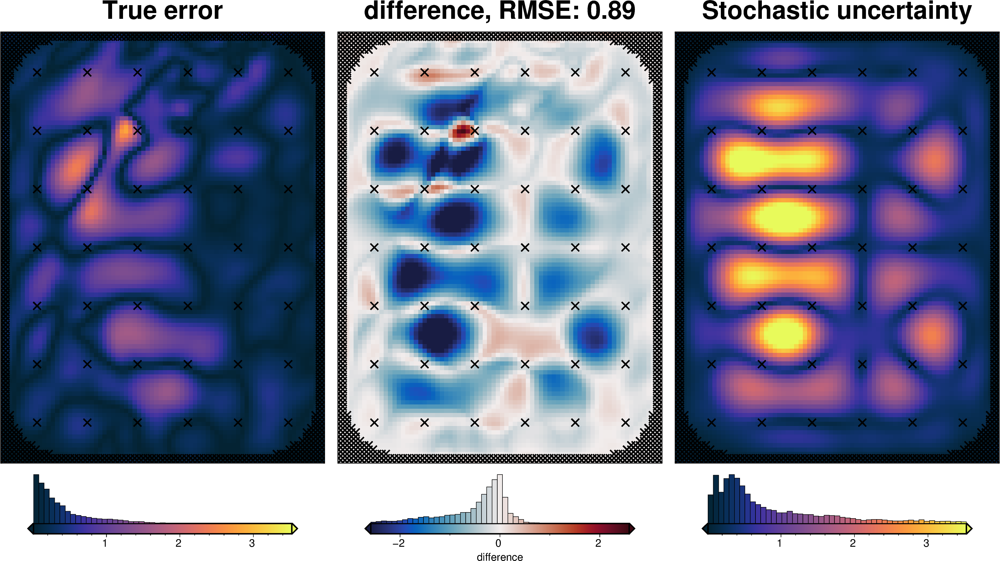

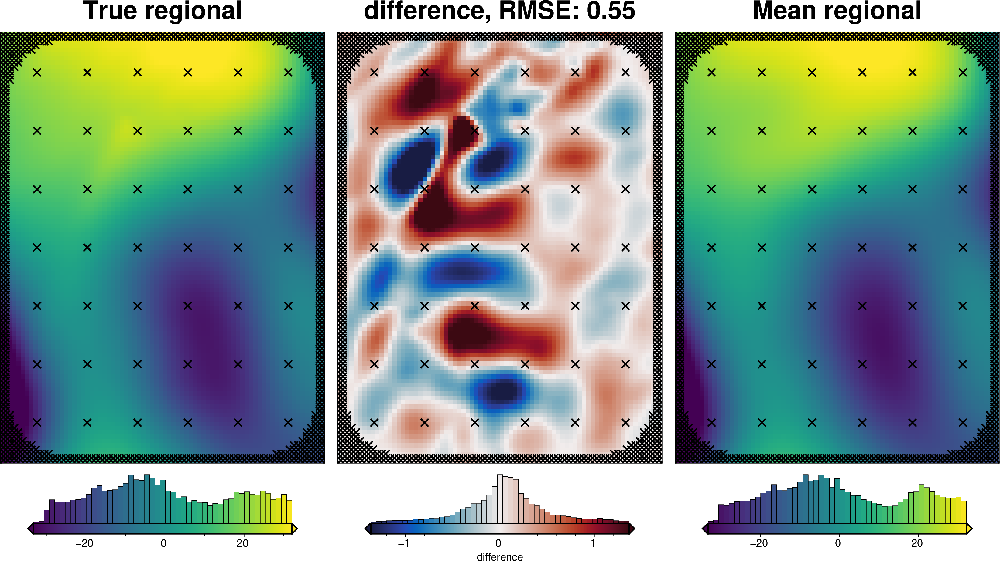

In [45]:
regional_misfit_parameter_dict = {
    "depth": {
        "distribution": "normal",
        "loc": reg_eq_depth,  # mean
        "scale": reg_eq_depth / 4,  # standard deviation
    },
    # "damping": {
    #     "distribution": "normal",
    #     "loc": np.log10(reg_eq_damping),  # mean base 10 exponent
    #     "scale": 2, #np.abs(np.log10(reg_eq_damping))/4,  # standard deviation of exponent
    #     "log": True,
    # },
}

regional_misfit_stats = uncertainty.regional_misfit_uncertainty(
    runs=20,
    parameter_dict=regional_misfit_parameter_dict,
    plot_region=inversion_region,
    true_regional=grav_df_true_density.set_index(["northing","easting"]).to_xarray().basement_grav,
    weight_by="constraints",
    # weight_by=None,
    grav_df=grav_df_true_density,
    **new_true_density_reg_kwargs,
)

In [46]:
grav_grid = grav_df_true_density.set_index(["northing", "easting"]).to_xarray()
grav_grid["reg_uncert"] = regional_misfit_stats.z_stdev
grav_df_true_density = vd.grid_to_table(grav_grid)
grav_df_true_density

,northing,easting,upward,bathymetry_grav,basement_grav_normalized,basement_grav,gravity_anomaly,starting_gravity,true_res,misfit,reg,res,reg_uncert
0,-1600000.0,-40000.0,1000.0,-35.551041,-0.576200,-36.298936,-71.849978,-35.578552,-3.009683,-36.271426,-36.368591,0.097165,0.221097
1,-1600000.0,-38000.0,1000.0,-36.054652,-0.523887,-33.944812,-69.999465,-36.042636,-3.088827,-33.956829,-33.947937,-0.008892,0.127489
2,-1600000.0,-36000.0,1000.0,-36.473148,-0.467097,-31.389260,-67.862409,-36.460093,-3.125503,-31.402316,-31.353333,-0.048984,0.157625
3,-1600000.0,-34000.0,1000.0,-36.755612,-0.406792,-28.675560,-65.431172,-36.784646,-3.111119,-28.646526,-28.625488,-0.021038,0.172964
4,-1600000.0,-32000.0,1000.0,-36.951032,-0.343951,-25.847705,-62.798738,-36.998466,-3.110972,-25.800271,-25.799377,-0.000894,0.157999
...,...,...,...,...,...,...,...,...,...,...,...,...,...
7671,-1400000.0,102000.0,1000.0,-25.760380,0.399106,7.589836,-18.170543,-25.498181,-2.438873,7.327637,7.342407,-0.014770,0.132675
7672,-1400000.0,104000.0,1000.0,-25.911731,0.334770,4.694748,-21.216982,-25.673783,-2.429612,4.456801,4.434082,0.022719,0.143883
7673,-1400000.0,106000.0,1000.0,-26.033127,0.268772,1.724824,-24.308303,-25.808796,-2.427521,1.500493,1.426880,0.073614,0.124930
7674,-1400000.0,108000.0,1000.0,-26.122232,0.201841,-1.287092,-27.409324,-25.904539,-2.429056,-1.504784,-1.613159,0.108375,0.068923


In [47]:
grav_df_true_density.to_csv(f"{fpath}_grav_df_true_density.csv", index=False)

# Uncertainty analysis

## Inversion error

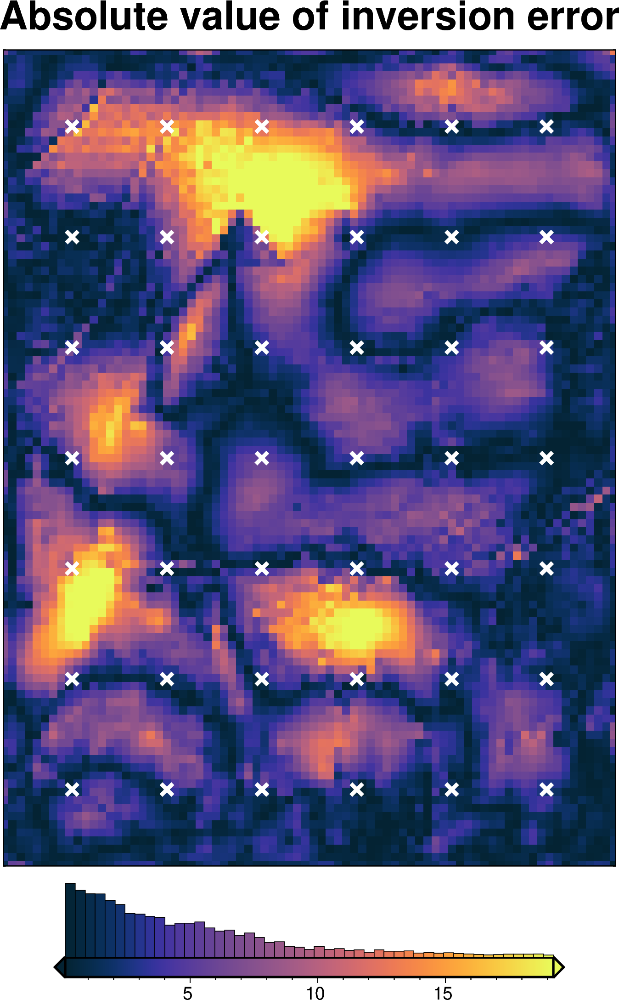

In [48]:
inversion_error = np.abs(bathymetry - final_topography)

fig = maps.plot_grd(
    inversion_error,
    # region=vd.pad_region(inversion_region, -3*spacing),
    region=inversion_region,
    hist=True,
    cmap="thermal",
    title="Absolute value of inversion error",
    robust=True,
    points=constraint_points[constraint_points.inside],
    points_style="x.3c",
    points_fill="white",
    points_pen="2p",
)
fig.show()

In [49]:
# re-load the study from the saved pickle file
with pathlib.Path(f"{regional_grav_kwargs.get('cv_kwargs').get('fname')}.pickle").open(
    "rb"
) as f:
    study = pickle.load(f)
reg_eq_depth = min(study.best_trials, key=lambda t: t.values[0]).params["depth"]
# reg_eq_damping = min(study.best_trials, key=lambda t: t.values[0]).params["damping"]
reg_eq_damping = None

new_regional_grav_kwargs = dict(
    method="constraints",
    grid_method="eq_sources",
    constraints_df=constraint_points,
    damping=reg_eq_damping,
    depth=reg_eq_depth,
    block_size=None,
)
reg_eq_depth, reg_eq_damping

(281862.9250746396, None)

In [64]:
# kwargs to reuse for all uncertainty analyses
uncert_kwargs = dict(
    grav_df=grav_df,
    density_contrast=best_density_contrast,
    zref=zref,
    starting_prisms=starting_prisms,
    starting_topography=starting_bathymetry,
    regional_grav_kwargs=new_regional_grav_kwargs,
    **kwargs,
)

## Solver damping component

In [65]:
# load study
with pathlib.Path(f"{fpath}_damping_cv_damping_cv_study.pickle").open(
    "rb"
) as f:
    study = pickle.load(f)

study_df = study.trials_dataframe().drop(columns=["user_attrs_results"])
study_df = study_df.sort_values("value")

# calculate zscores of values
study_df["value_zscore"] = sp.stats.zscore(study_df["value"])

# drop outliers (values with zscore > |2|)
study_df2 = study_df[(np.abs(study_df.value_zscore) < 2)]

# pick damping standard deviation based on optimization
stdev = np.log10(study_df2.params_damping).std()
print(f"calculated stdev: {stdev}")
stdev = stdev / 2
print(f"using stdev: {stdev}")

calculated stdev: 0.48313359890957897
using stdev: 0.24156679945478948


best: 0.01343800976396253 
std: 0.24156679945478948 
+1std: 0.023436985523163357 
-1std: 0.007704920337894153


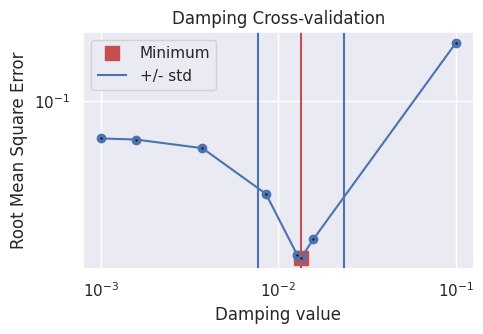

In [66]:
fig = plotting.plot_cv_scores(
    study_df.value,
    study_df.params_damping,
    param_name="Damping",
    logx=True,
    logy=True,
)
ax = fig.axes[0]

best = float(study_df2.params_damping.iloc[0])
upper = float(10 ** (np.log10(best) + stdev))
lower = float(10 ** (np.log10(best) - stdev))

y_lims = ax.get_ylim()
ax.vlines(best, ymin=y_lims[0], ymax=y_lims[1], color="r")
ax.vlines(upper, ymin=y_lims[0], ymax=y_lims[1], label="+/- std")
ax.vlines(lower, ymin=y_lims[0], ymax=y_lims[1])

x_lims = ax.get_xlim()
ax.set_xlim(
    min(x_lims[0], lower),
    max(x_lims[1], upper),
)
ax.legend()
print("best:", best, "\nstd:", stdev, "\n+1std:", upper, "\n-1std:", lower)

INFO:invert4geom:Sampled 'solver_damping' parameter values; mean: 0.015362565891314073, min: 0.005382610150801347, max: 0.03354879906906653
INFO:invert4geom:No pickle files starting with '../results/Ross_Sea/Ross_Sea_04_uncertainty_damping' found, creating new files



stochastic ensemble:   0%|          | 0/10 [00:00<?, ?it/s]

INFO:invert4geom:starting stochastic uncertainty analysis at run 0 of 10
saving results to pickle files with prefix: '../results/Ross_Sea/Ross_Sea_04_uncertainty_damping'



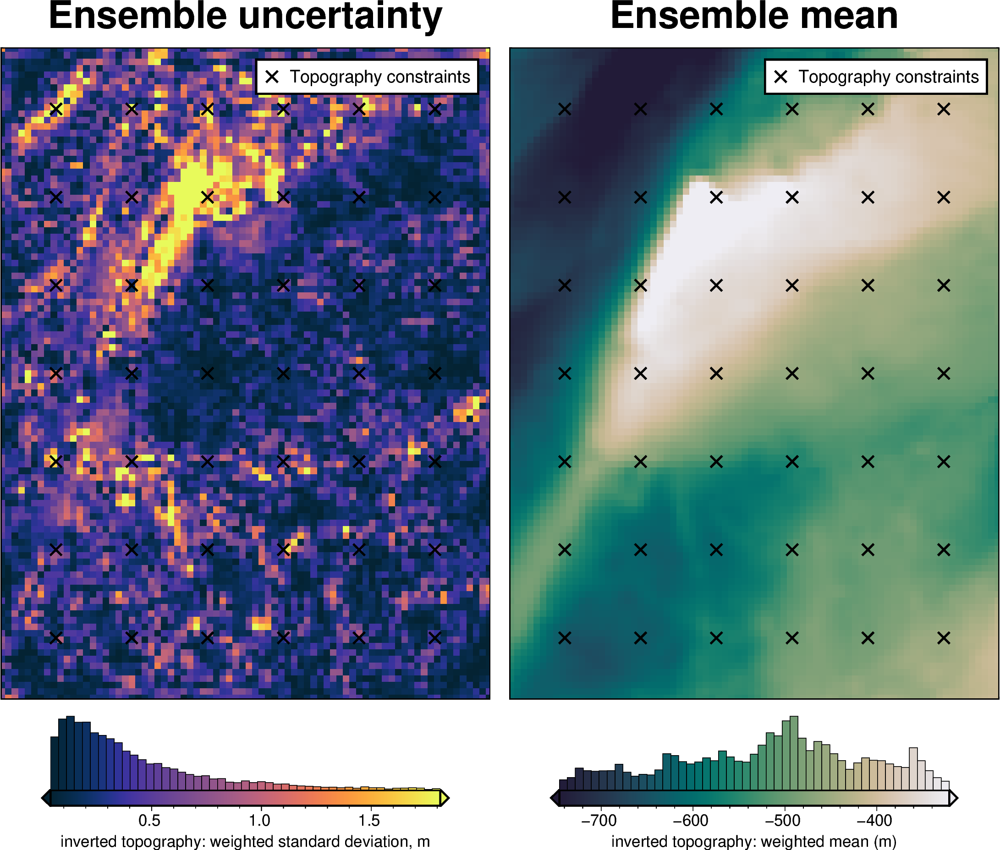

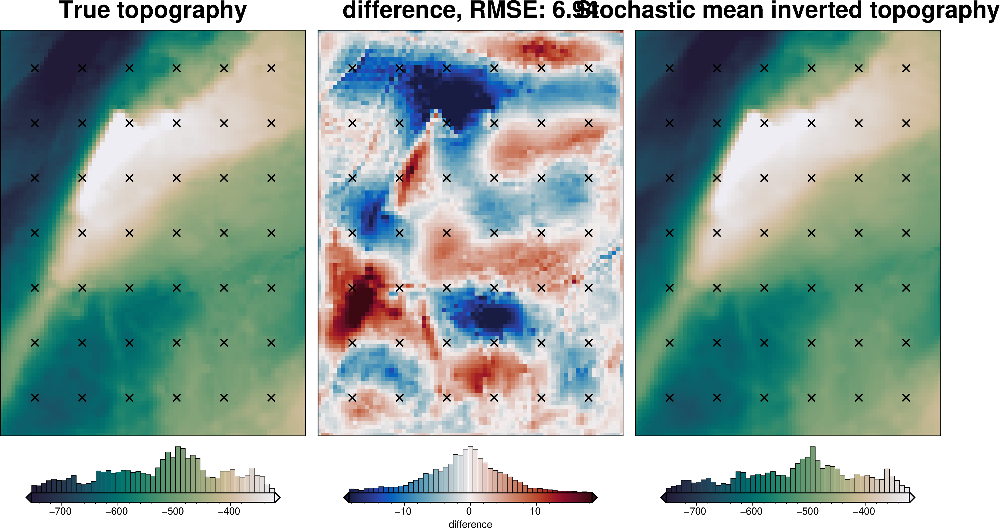

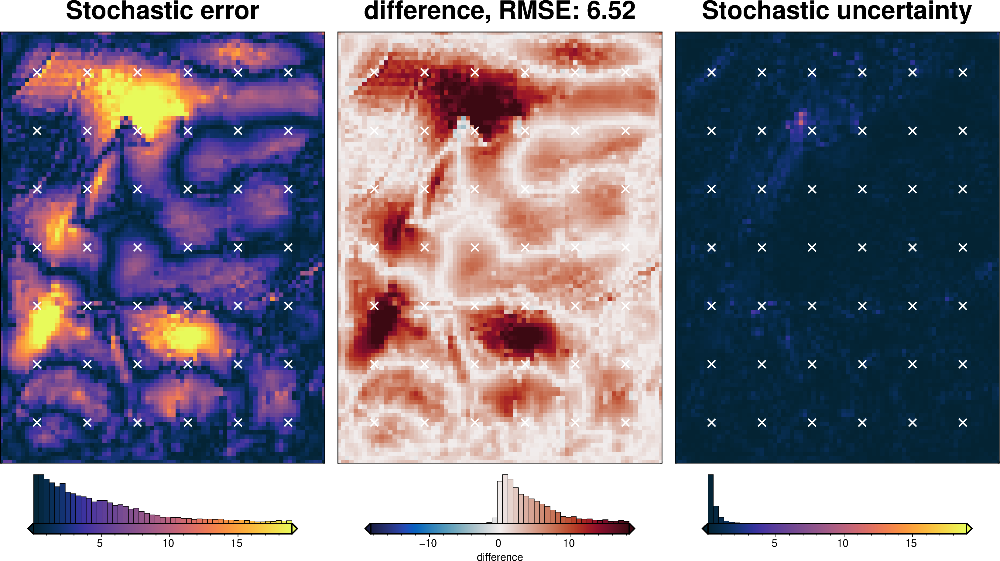

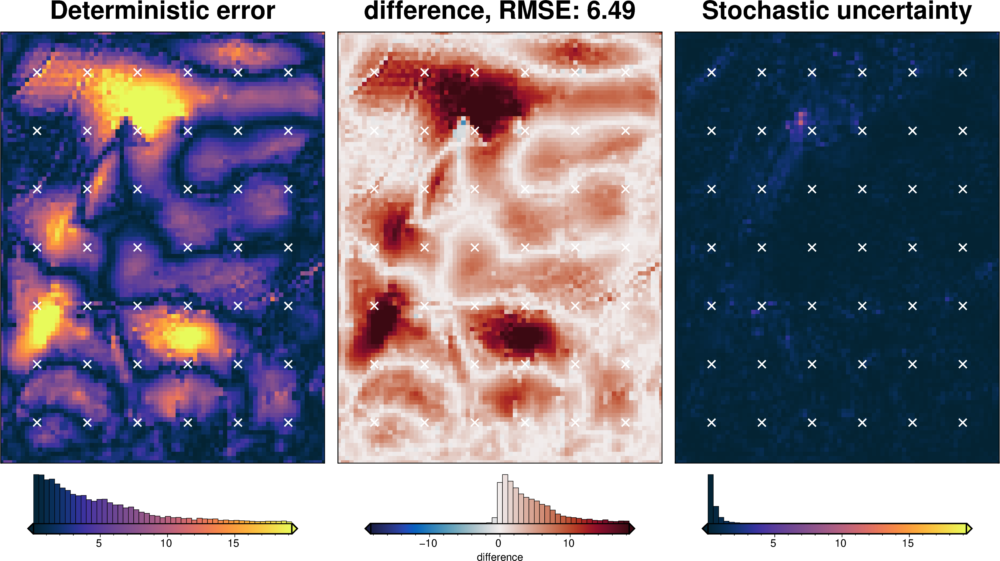

In [67]:
solver_dict = {
    "solver_damping": {
        "distribution": "normal",
        "loc": np.log10(best_damping),  # mean of base 10 exponent
        "scale": stdev,  # 0.2,  # standard deviation of base 10 exponent
        "log": True,
    },
}
fname = f"{fpath}_uncertainty_damping"

# delete files if already exist
for p in pathlib.Path().glob(f"{fname}*"):
    p.unlink(missing_ok=True)

uncert_damping_results = uncertainty.full_workflow_uncertainty_loop(
    fname=fname,
    runs=10,
    parameter_dict=solver_dict,
    **uncert_kwargs,
)

stats_ds = synth_plotting.uncert_plots(
    uncert_damping_results,
    inversion_region,
    bathymetry,
    deterministic_bathymetry=final_topography,
    constraint_points=constraint_points[constraint_points.inside],
    weight_by="constraints",
    # weight_by="residual",
    # weight_by=None,
)

## Density component

In [68]:
# load study
with pathlib.Path(f"{fpath}_density_cv_kfolds_study.pickle").open(
    "rb"
) as f:
    study = pickle.load(f)

study_df = study.trials_dataframe()
study_df = study_df.sort_values("value")

# calculate zscores of values
study_df["value_zscore"] = sp.stats.zscore(study_df["value"])

# drop outliers (values with zscore > |2|)
study_df2 = study_df[(np.abs(study_df.value_zscore) < 2)]

stdev = study_df2.params_density_contrast.std()
print(f"calculated stdev: {stdev}")

# manually pick a stdev
stdev = 500
print(f"using stdev: {stdev}")

print(
    f"density estimation error: {np.abs(true_density_contrast - best_density_contrast)}"
)

calculated stdev: 208.03338892853452
using stdev: 500
density estimation error: 623


best: 2099 
std: 500 
+1std: 2599 
-1std: 1599


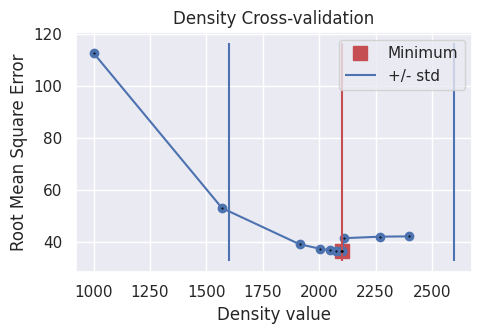

In [69]:
fig = plotting.plot_cv_scores(
    study.trials_dataframe().value.values,
    study.trials_dataframe().params_density_contrast.values,
    param_name="Density",
    logx=False,
    logy=False,
)
ax = fig.axes[0]

best = study_df2.params_density_contrast.iloc[0]
upper = best + stdev
lower = best - stdev

y_lims = ax.get_ylim()
ax.vlines(best, ymin=y_lims[0], ymax=y_lims[1], color="r")
ax.vlines(upper, ymin=y_lims[0], ymax=y_lims[1], label="+/- std")
ax.vlines(lower, ymin=y_lims[0], ymax=y_lims[1])

x_lims = ax.get_xlim()
ax.set_xlim(
    min(x_lims[0], lower),
    max(x_lims[1], upper),
)
ax.legend()
print("best:", best, "\nstd:", stdev, "\n+1std:", upper, "\n-1std:", lower)

INFO:invert4geom:Sampled 'density_contrast' parameter values; mean: 2099.0, min: 1276.5731865242635, max: 2921.4268134757363
INFO:invert4geom:No pickle files starting with '../results/Ross_Sea/Ross_Sea_04_uncertainty_density' found, creating new files



stochastic ensemble:   0%|          | 0/10 [00:00<?, ?it/s]

INFO:invert4geom:starting stochastic uncertainty analysis at run 0 of 10
saving results to pickle files with prefix: '../results/Ross_Sea/Ross_Sea_04_uncertainty_density'



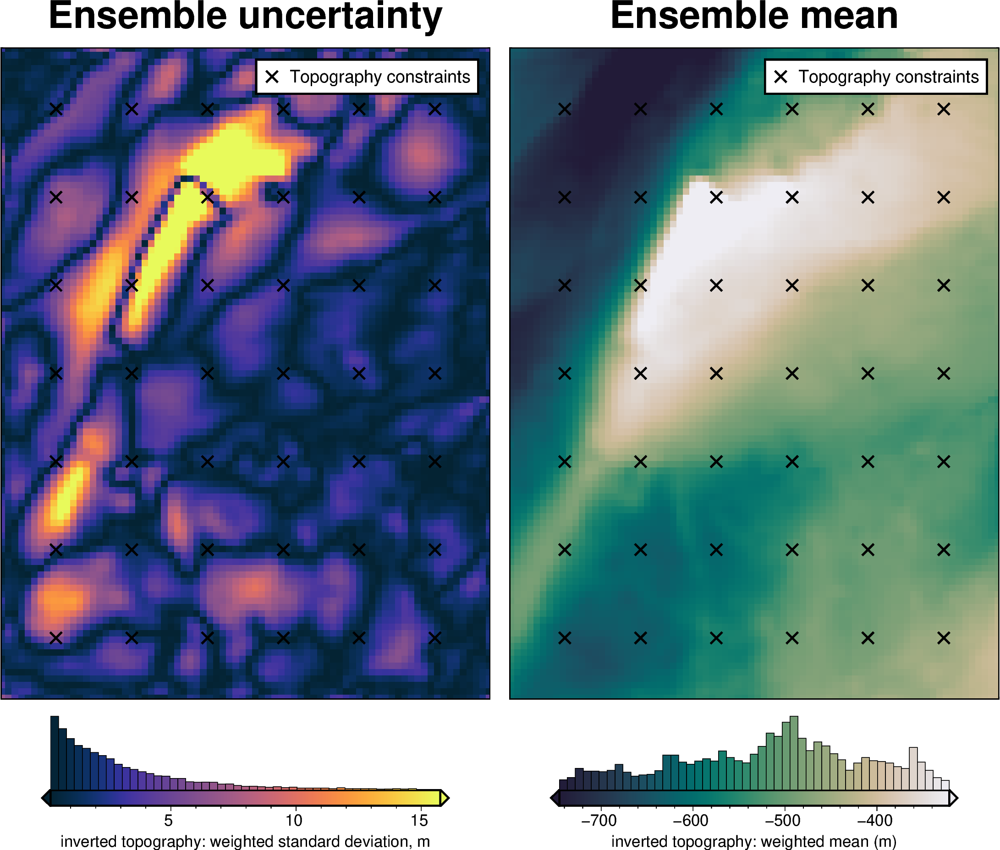

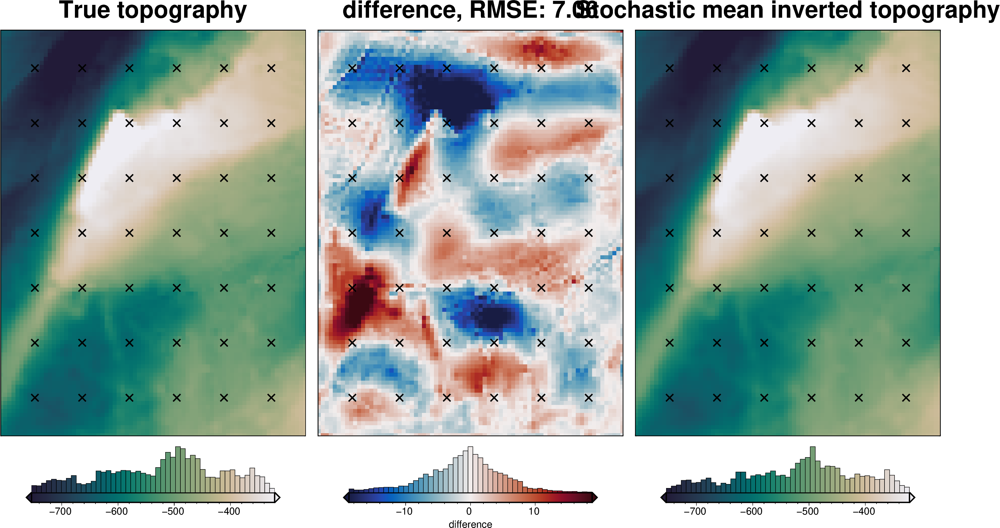

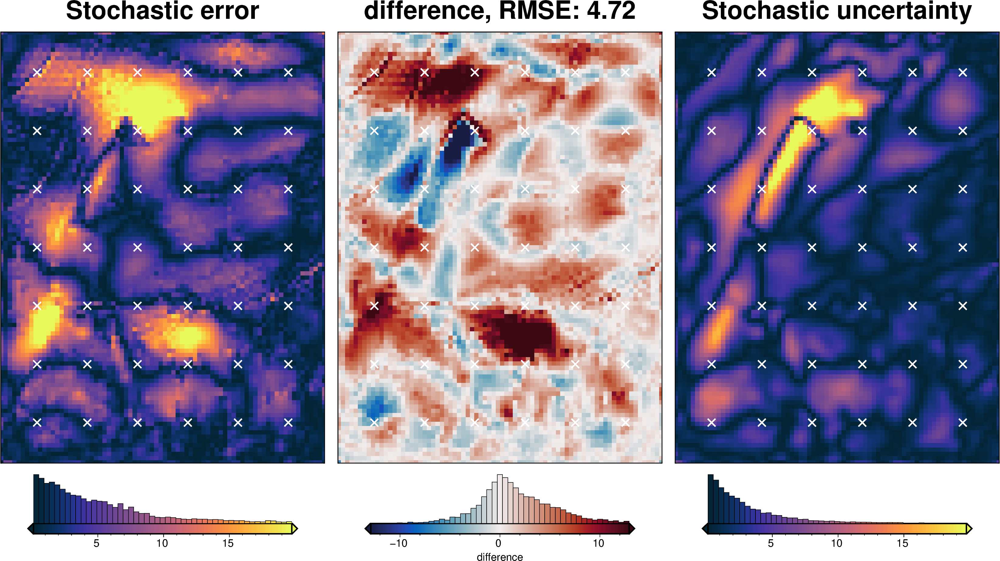

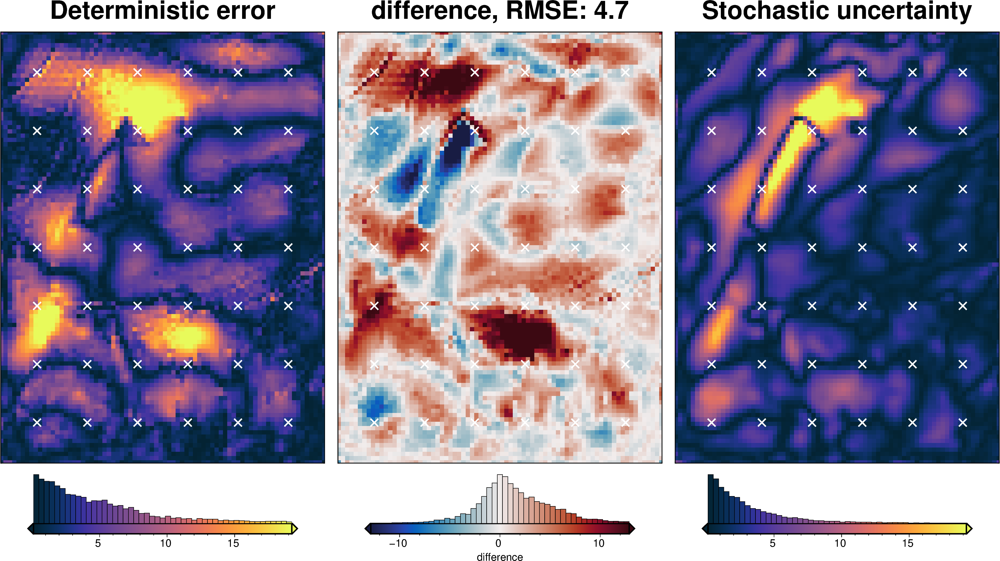

In [70]:
density_dict = {
    "density_contrast": {
        "distribution": "normal",
        "loc": best_density_contrast,
        "scale": stdev,
    },
}
fname = f"{fpath}_uncertainty_density"

# delete files if already exist
for p in pathlib.Path().glob(f"{fname}*"):
    p.unlink(missing_ok=True)

uncert_density_results = uncertainty.full_workflow_uncertainty_loop(
    fname=fname,
    runs=10,
    parameter_dict=density_dict,
    **uncert_kwargs,
)

stats_ds = synth_plotting.uncert_plots(
    uncert_density_results,
    inversion_region,
    bathymetry,
    deterministic_bathymetry=final_topography,
    constraint_points=constraint_points[constraint_points.inside],
    weight_by="constraints",
    # weight_by="residual",
    # weight_by=None,
)

## Regional gravity component

In [71]:
# reg_eq_depth, reg_eq_damping

In [72]:
# regional_misfit_parameter_dict = {
#     "depth": {
#         "distribution": "normal",
#         "loc": reg_eq_depth,  # mean
#         "scale": reg_eq_depth / 4,  # standard deviation
#     },
#     # "damping": {
#     #     "distribution": "normal",
#     #     "loc": np.log10(reg_eq_damping),  # mean base 10 exponent
#     #     "scale": 2,  # np.abs(np.log10(reg_eq_damping)),  # standard deviation of exponent
#     #     "log": True,
#     # },
# }

# regional_misfit_stats = uncertainty.regional_misfit_uncertainty(
#     runs=20,
#     parameter_dict=regional_misfit_parameter_dict,
#     plot_region=inversion_region,
#     true_regional=grav_grid.basement_grav,
#     weight_by="constraints",
#     # weight_by="residual",
#     # weight_by=None,
#     grav_df=grav_df,
#     **new_regional_grav_kwargs,
# )

In [73]:
# grav_grid = grav_df.set_index(["northing", "easting"]).to_xarray()
# grav_grid["reg_uncert"] = regional_misfit_stats.z_stdev
# grav_df_new = vd.grid_to_table(grav_grid)
# grav_df_new

In [74]:
# # save to csv
# grav_df_new.to_csv(f"{fpath}_grav_df.csv", index=False)

In [75]:
# # update grav_df
# uncert_kwargs["grav_df"] = grav_df_new

In [76]:
# fname = f"{fpath}_uncertainty_regional"

# # delete files if already exist
# for p in pathlib.Path().glob(f"{fname}*"):
#     p.unlink(missing_ok=True)

# uncert_regional_results = uncertainty.full_workflow_uncertainty_loop(
#     fname=fname,
#     runs=10,
#     regional_misfit_parameter_dict=regional_misfit_parameter_dict,
#     **uncert_kwargs,
# )

# stats_ds = synth_plotting.uncert_plots(
#     uncert_regional_results,
#     inversion_region,
#     bathymetry,
#     deterministic_bathymetry=final_topography,
#     constraint_points=constraint_points[constraint_points.inside],
#     weight_by="constraints",
#     # weight_by="residual",
#     # weight_by=None,
# )

## Total uncertainty

INFO:invert4geom:Sampled 'solver_damping' parameter values; mean: 0.01551125110101203, min: 0.004517235427258928, max: 0.03997580142196155
INFO:invert4geom:Sampled 'density_contrast' parameter values; mean: 2099.0000000000005, min: 1119.0180077299729, max: 3078.981992270028
INFO:invert4geom:No pickle files starting with '../results/Ross_Sea/Ross_Sea_04_uncertainty_full' found, creating new files



stochastic ensemble:   0%|          | 0/20 [00:00<?, ?it/s]

INFO:invert4geom:starting stochastic uncertainty analysis at run 0 of 20
saving results to pickle files with prefix: '../results/Ross_Sea/Ross_Sea_04_uncertainty_full'



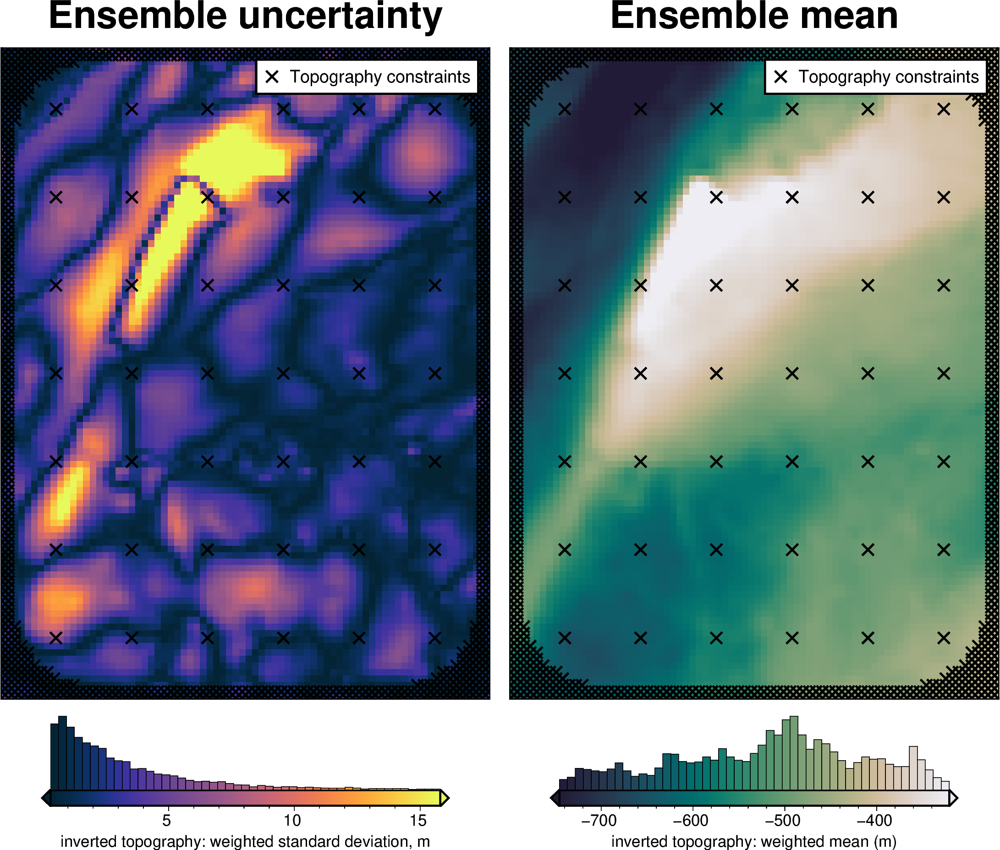

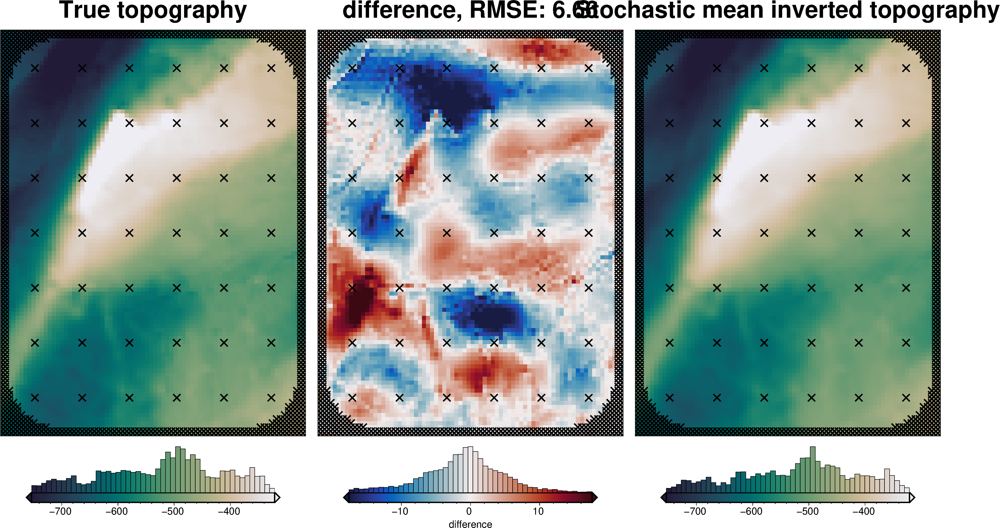

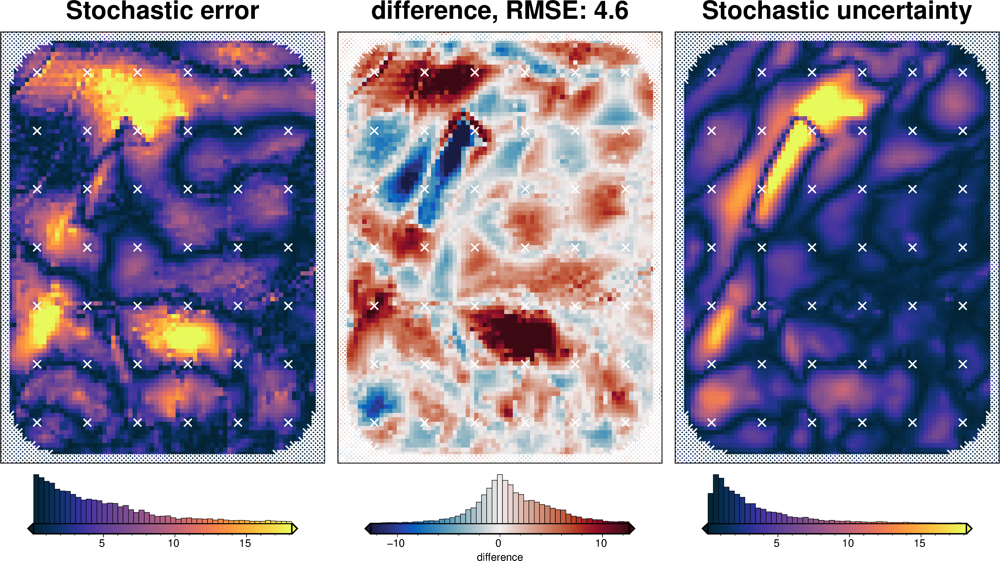

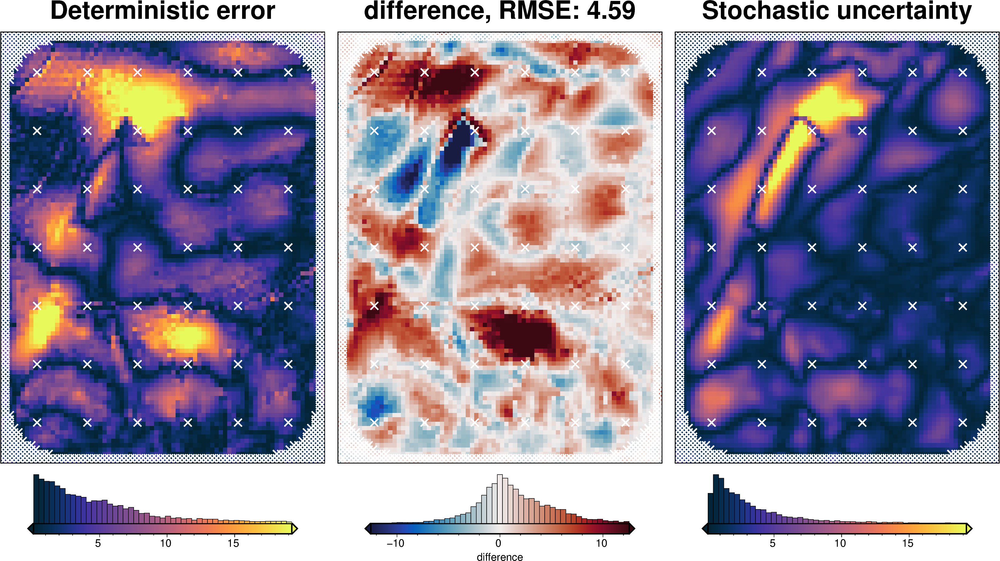

In [77]:
fname = f"{fpath}_uncertainty_full"

# delete files if already exist
for p in pathlib.Path().glob(f"{fname}*"):
    p.unlink(missing_ok=True)

uncert_results = uncertainty.full_workflow_uncertainty_loop(
    fname=fname,
    runs=20,
    parameter_dict=solver_dict | density_dict,
    # regional_misfit_parameter_dict=regional_misfit_parameter_dict,
    **uncert_kwargs,
)

stats_ds = synth_plotting.uncert_plots(
    uncert_results,
    inversion_region,
    bathymetry,
    deterministic_bathymetry=final_topography,
    constraint_points=constraint_points,
    weight_by="constraints",
    # weight_by="residual",
    # weight_by=None,
)

### Comparing results

In [78]:
results = [
    uncert_results,
    # uncert_regional_results,
    uncert_density_results,
    uncert_damping_results,
]

# get cell-wise stats for each ensemble
stats = []
for r in results:
    ds = uncertainty.merged_stats(
        results=r,
        plot=False,
        constraints_df=constraint_points,
        weight_by="constraints",
        # region=vd.pad_region(inversion_region, -spacing),
        region=inversion_region,
    )
    stats.append(ds)

In [79]:
names = [
    "full",
    # "regional",
    "density",
    "damping",
]

# get the standard deviation of the ensemble of ensembles
stdevs = []
for i, s in enumerate(stats):
    stdevs.append(s.weighted_stdev.rename(f"{names[i]}_stdev"))

merged = xr.merge(stdevs)
merged

<xarray.Dataset> Size: 186kB
Dimensions:        (northing: 101, easting: 76)
Coordinates:
  * northing       (northing) float64 808B -1.6e+06 -1.598e+06 ... -1.4e+06
  * easting        (easting) float64 608B -4e+04 -3.8e+04 ... 1.08e+05 1.1e+05
Data variables:
    full_stdev     (northing, easting) float64 61kB 6.417 4.946 ... 2.528 3.935
    density_stdev  (northing, easting) float64 61kB 6.666 5.574 ... 2.553 3.734
    damping_stdev  (northing, easting) float64 61kB 0.621 1.226 ... 0.8646 2.862

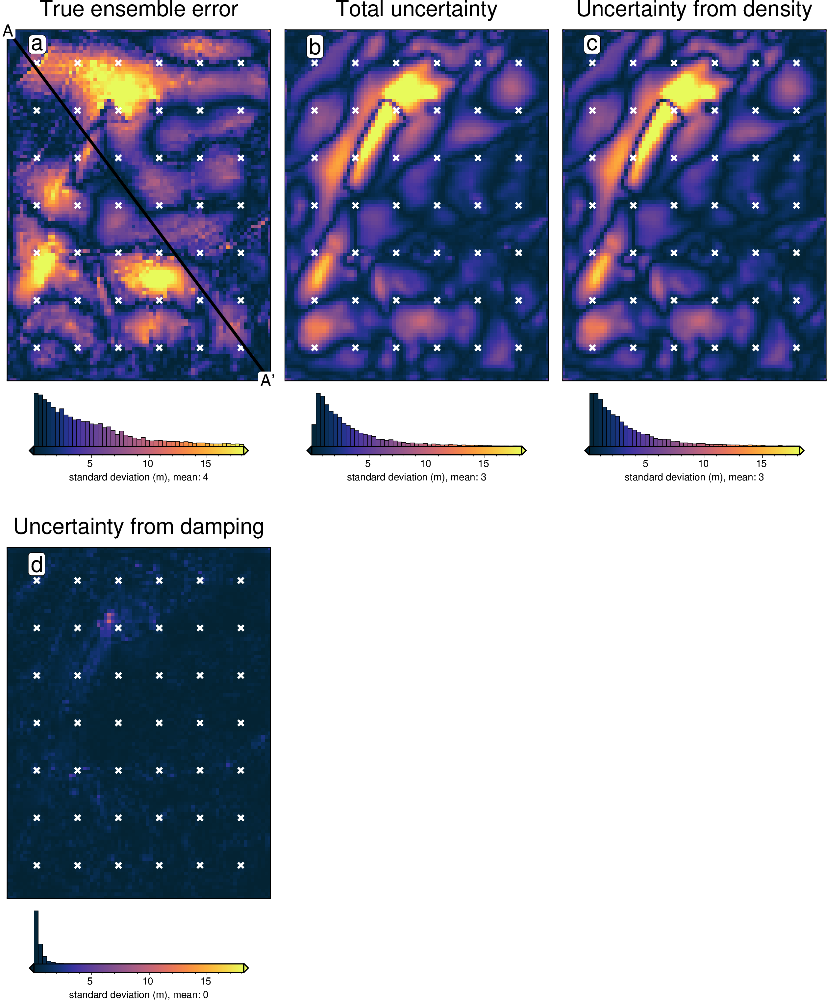

In [80]:
titles = [
    "True ensemble error",
    # "True indiv error",
    "Total uncertainty",
    # "Uncertainty from regional",
    "Uncertainty from density",
    "Uncertainty from damping",
]
grids = list(merged.data_vars.values())

grids.insert(0, np.abs(stats[0].weighted_mean - bathymetry))

# cpt_lims = polar_utils.get_min_max(grids[0], robust=True,)
cpt_lims = polar_utils.get_combined_min_max(grids, robust=True)

fig_height = 9
for i, g in enumerate(grids):
    xshift_amount = 1
    if i == 0:
        fig = None
        origin_shift = "initialize"
    elif i == 3:
        origin_shift = "both_shift"
        xshift_amount = -2
    else:
        origin_shift = "xshift"

    fig = maps.plot_grd(
        grid=g,
        fig_height=fig_height,
        # region=vd.pad_region(inversion_region, -3*spacing),
        title=titles[i],
        title_font="16p,Helvetica,black",
        cmap="thermal",
        cpt_lims=cpt_lims,
        robust=True,
        cbar_label=f"standard deviation (m), mean: {int(np.nanmean(g))}",
        hist=True,
        hist_bin_num=50,
        fig=fig,
        origin_shift=origin_shift,
        xshift_amount=xshift_amount,
        # yshift_amount=-1.1,
    )
    fig.plot(
        x=constraint_points[constraint_points.inside].easting,
        y=constraint_points[constraint_points.inside].northing,
        style="x.2c",
        fill="white",
        pen="1.5p,white",
    )
    fig.text(
        position="TL",
        text=f"{string.ascii_lowercase[i]}",
        fill="white",
        pen=True,
        font="16p,Helvetica,black",
        offset="j.6/.2",
        clearance="+tO",
        no_clip=True,
    )
    if i == 0:
        # plot profiles location, and endpoints on map
        start = [inversion_region[0], inversion_region[3]]
        stop = [inversion_region[1], inversion_region[2]]
        fig.plot(
            vd.line_coordinates(start, stop, size=100),
            pen="2p,black",
        )
        fig.text(
            x=start[0],
            y=start[1],
            text="A",
            fill="white",
            font="12p,Helvetica,black",
            justify="CM",
            clearance="+tO",
            no_clip=True,
        )
        fig.text(
            x=stop[0],
            y=stop[1],
            text="A' ",
            fill="white",
            font="12p,Helvetica,black",
            justify="CM",
            clearance="+tO",
            no_clip=True,
        )
fig.show()

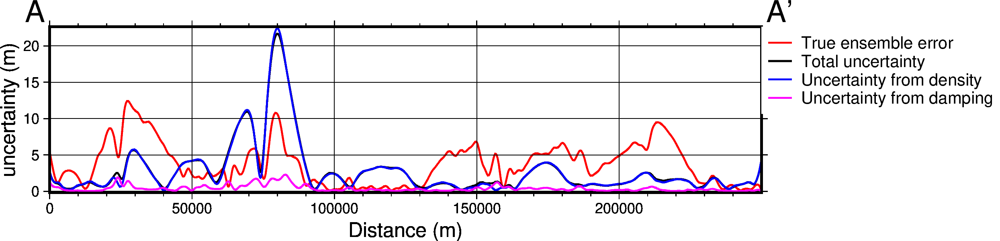

In [81]:
data_dict = profiles.make_data_dict(
    names=titles,
    grids=grids,
    colors=[
        "red",
        "black",
        "blue",
        "magenta",
        "cyan",
        "green",
        "purple",
    ],
)

fig, df_data = profiles.plot_data(
    "points",
    start=[inversion_region[0], inversion_region[3]],
    stop=[inversion_region[1], inversion_region[2]],
    num=10000,
    fig_height=4,
    fig_width=15,
    data_dict=data_dict,
    data_legend_loc="jTR+jTL",
    data_legend_box="+gwhite",
    data_buffer=0.01,
    data_frame=["neSW", "xafg+lDistance (m)", "yag+luncertainty (m)"],
    # data_pen_style=[None,None,"4_2:2p"],
    # data_pen_thickness=[1, 1.5, 1],
    share_yaxis=True,
    start_label="A",
    end_label="A' ",
)
fig.show()

In [82]:
# save results
merged.to_netcdf(f"{fpath}_sensitivity.nc")

In [83]:
stats_ds.to_netcdf(f"{fpath}_uncertainty.nc")